# <span style="background-color: yellow;text-align: center;">*_Importing Libraries_*

In [2]:
## import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# <span style="background-color: yellow;text-align: center;">*_Reading & Loading data from the .csv file_*

In [4]:
## reading data from the .csv file
pd.set_option('display.max_rows', None)
loan_data = pd.read_csv("loan.csv")
loan_data.head(10)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
5,1075269,1311441,5000,5000,5000.0,36 months,7.90%,156.46,A,A4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
6,1069639,1304742,7000,7000,7000.0,60 months,15.96%,170.08,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
7,1072053,1288686,3000,3000,3000.0,36 months,18.64%,109.43,E,E1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
8,1071795,1306957,5600,5600,5600.0,60 months,21.28%,152.39,F,F2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
9,1071570,1306721,5375,5375,5350.0,60 months,12.69%,121.45,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


# <span style="background-color: yellow;text-align: center;">*_DATA CLEANING AND MANUPULATION_*

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_View column name and datatype of the data frame_*

In [7]:
## view column name and datatype of the data frame
loan_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 111 columns):
 #    Column                          Dtype  
---   ------                          -----  
 0    id                              int64  
 1    member_id                       int64  
 2    loan_amnt                       int64  
 3    funded_amnt                     int64  
 4    funded_amnt_inv                 float64
 5    term                            object 
 6    int_rate                        object 
 7    installment                     float64
 8    grade                           object 
 9    sub_grade                       object 
 10   emp_title                       object 
 11   emp_length                      object 
 12   home_ownership                  object 
 13   annual_inc                      float64
 14   verification_status             object 
 15   issue_d                         object 
 16   loan_status                     object 
 17   pymnt_plan

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_view the number of rows and columns from the data frame_*

In [9]:
## view the number of rows and columns from the data frame
print("Number of Rows in the Dataset=",loan_data.shape[0] ,"\nNumber of Columns in the DataSet=",loan_data.shape[1])

Number of Rows in the Dataset= 39717 
Number of Columns in the DataSet= 111


# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Dropping columns with all null valuesfrom the data frame_*

In [11]:
#Dropping columns with all null values
loan_data.dropna(how='all',inplace=True,axis=1)
loan_data.shape

(39717, 57)

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Identifying and Removing Single-Valued Columns_*

*Columns with a single unique value do not provide useful information for our analysis. Therefore, we will remove these columns.*

In [13]:
## Identifying and Removing Single-Valued Columns
single_valued_columns = [col for col in loan_data.columns if loan_data[col].nunique() <= 1]
loan_data.drop(single_valued_columns, axis=1, inplace=True)
loan_data.shape
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 48 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       39717 non-null  int64  
 1   member_id                39717 non-null  int64  
 2   loan_amnt                39717 non-null  int64  
 3   funded_amnt              39717 non-null  int64  
 4   funded_amnt_inv          39717 non-null  float64
 5   term                     39717 non-null  object 
 6   int_rate                 39717 non-null  object 
 7   installment              39717 non-null  float64
 8   grade                    39717 non-null  object 
 9   sub_grade                39717 non-null  object 
 10  emp_title                37258 non-null  object 
 11  emp_length               38642 non-null  object 
 12  home_ownership           39717 non-null  object 
 13  annual_inc               39717 non-null  float64
 14  verification_status   

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Removing Irrelevant Columns for analysis_*
*Columns such as `id`, `member_id`, `url`, `zip_code`, `last_credit_pull_d`, `desc`,`collection_recovery_fee`,`total_rec_late_fee`,
`total_rec_int`,`delinq_2yrs`,`recoveries`,`delinq_2yrs`,`earliest_cr_line`,`total_acc`,`out_prncp`,`out_prncp_inv`,`total_pymnt_inv`,`total_rec_prncp`,
`last_pymnt_d` & `out_prncp_inv`
do not contribute to loan risk analysis. Hence, we will remove these columns from the dataset.*

In [15]:
### Removing Irrelevant Columns for analysis
loan_data.drop(['id','member_id','url','zip_code','last_credit_pull_d','desc','collection_recovery_fee','total_rec_late_fee','total_rec_int','delinq_2yrs','recoveries','delinq_2yrs','earliest_cr_line','total_acc','out_prncp','out_prncp_inv','total_pymnt_inv','total_rec_prncp','last_pymnt_d','out_prncp_inv'],axis=1,inplace=True)

In [16]:
loan_data.shape

(39717, 30)

In [17]:
round(loan_data.isnull().mean()*100,2)

loan_amnt                  0.00
funded_amnt                0.00
funded_amnt_inv            0.00
term                       0.00
int_rate                   0.00
installment                0.00
grade                      0.00
sub_grade                  0.00
emp_title                  6.19
emp_length                 2.71
home_ownership             0.00
annual_inc                 0.00
verification_status        0.00
issue_d                    0.00
loan_status                0.00
purpose                    0.00
title                      0.03
addr_state                 0.00
dti                        0.00
inq_last_6mths             0.00
mths_since_last_delinq    64.66
mths_since_last_record    92.99
open_acc                   0.00
pub_rec                    0.00
revol_bal                  0.00
revol_util                 0.13
total_pymnt                0.00
last_pymnt_amnt            0.00
next_pymnt_d              97.13
pub_rec_bankruptcies       1.75
dtype: float64

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Removing Columns with More Than 60% Missing Values_*
*Columns with more than 60% missing values cannot be imputed without introducing bias into our analysis. Therefore, we will remove these columns.*

In [19]:
### Removing Columns with More Than 60% Missing Values
missing_percentage=round(loan_data.isnull().mean()*100,2)
cols_to_remove=missing_percentage[round(loan_data.isnull().mean()*100,2)>=60].index.to_list()
cols_to_remove

['mths_since_last_delinq', 'mths_since_last_record', 'next_pymnt_d']

In [20]:
loan_data.drop(cols_to_remove,axis=1,inplace=True)
loan_data.shape


(39717, 27)

In [21]:

loan_data=loan_data[~(loan_data.home_ownership=='NONE')]

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Filtering Loan Status for Analysis_*
*The objective of this analysis is to determine the likelihood of loan default. This can only be assessed for loans that are either fully paid or charged off.*

*Current loans cannot provide meaningful insights into default risk.*

*Therefore, we will exclude records with a current loan status from our dataset.*

In [23]:
## exclude records with a current loan status from our dataset
loan_data=loan_data[~(loan_data['loan_status']=='Current')]
loan_data.loan_status.value_counts()

loan_status
Fully Paid     32947
Charged Off     5627
Name: count, dtype: int64

# <span style="background-color: yellow;text-align: center;">*_Checking and Imputing Missing Values_*
*To ensure the quality of our data, we need to identify and handle missing values appropriately.*

*Imputing missing values helps maintain the integrity of the dataset without introducing bias.*

In [25]:
missing_values=round(loan_data.isnull().mean()*100,2)
missing_values[missing_values>0]

emp_title               6.18
emp_length              2.68
title                   0.03
revol_util              0.13
pub_rec_bankruptcies    1.80
dtype: float64

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Handling Missing Values in Specific Columns_*
*The following columns have missing values:*

- *`emp_title`*
- *`emp_length`*
- *`title`*
- *`revol_util`*
- *`pub_rec_bankruptcies`*

*We will impute these missing values to maintain the integrity of our dataset.*


In [27]:
loan_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 38574 entries, 0 to 39716
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             38574 non-null  int64  
 1   funded_amnt           38574 non-null  int64  
 2   funded_amnt_inv       38574 non-null  float64
 3   term                  38574 non-null  object 
 4   int_rate              38574 non-null  object 
 5   installment           38574 non-null  float64
 6   grade                 38574 non-null  object 
 7   sub_grade             38574 non-null  object 
 8   emp_title             36190 non-null  object 
 9   emp_length            37541 non-null  object 
 10  home_ownership        38574 non-null  object 
 11  annual_inc            38574 non-null  float64
 12  verification_status   38574 non-null  object 
 13  issue_d               38574 non-null  object 
 14  loan_status           38574 non-null  object 
 15  purpose               38

In [28]:
loan_data.emp_title.value_counts()

emp_title
US Army                                                                           131
Bank of America                                                                   107
IBM                                                                                65
AT&T                                                                               57
Kaiser Permanente                                                                  56
USAF                                                                               52
Wells Fargo                                                                        52
UPS                                                                                52
US Air Force                                                                       51
Walmart                                                                            45
United States Air Force                                                            42
Lockheed Martin                             

In [29]:
loan_data.emp_title.fillna("Unknown",inplace=True)
loan_data.emp_title.isnull().sum()

0

In [30]:
print("Mode:",loan_data.emp_length.mode()[0])
loan_data.emp_length.value_counts()

Mode: 10+ years


emp_length
10+ years    8488
< 1 year     4506
2 years      4291
3 years      4012
4 years      3342
5 years      3193
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: count, dtype: int64

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Imputing Missing Values with Mode_*
*The value counts for the `emp_length` column are as follows:*
*The mode value (`10+ years`) has a significantly higher frequency than the next most frequent value.*

*This indicates that we can safely assign the mode value to the null values in the `emp_length` column.*

*Additionally, the percentage of missing values is very low. Imputing with the mode value does not significantly affect our analysis.*




In [32]:
loan_data.emp_length.fillna(loan_data.emp_length.mode()[0],inplace=True)
loan_data.emp_length.isnull().sum()

0

# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Imputing Missing Values in Loan Purpose with Mode_*
*The `purpose` column indicates the reason for taking out a loan. One common purpose is `consolidation`, which is the mode of this column.*

*Since `consolidation` is the most frequent value, we can safely use it to fill any missing values in the `purpose` column.*

*Using the mode for imputation ensures that we maintain the integrity of the data without introducing significant bias, especially given the low percentage of missing values.*

In [34]:
loan_data.title.value_counts()
loan_data['title']=loan_data.title.apply(lambda x:'Consolidation' if 'consolidation' in str(x).lower() else str(x))

In [35]:
loan_data.title.value_counts()

title
Consolidation                                                                       8485
Personal Loan                                                                        641
Home Improvement                                                                     345
Small Business Loan                                                                  305
Personal                                                                             301
Credit Card Loan                                                                     301
Home Improvement Loan                                                                230
personal loan                                                                        227
personal                                                                             209
Loan                                                                                 206
Wedding Loan                                                                         201
Car Loan       

In [36]:
loan_data.title.fillna(loan_data.title.mode()[0],inplace=True)
loan_data.title.isna().sum()

0

In [37]:
loan_data.dropna(axis=0,subset=['revol_util'],inplace=True)
loan_data.revol_util.isna().sum()

0

In [38]:
loan_data.pub_rec_bankruptcies.value_counts()

pub_rec_bankruptcies
0.0    36189
1.0     1636
2.0        5
Name: count, dtype: int64

In [39]:
loan_data.pub_rec_bankruptcies.fillna(loan_data.pub_rec_bankruptcies.mode()[0],inplace=True)
loan_data.pub_rec_bankruptcies.isna().sum()

0

# <span style="background-color: yellow;text-align: center;">*_Standardizing the data_*
- **revol_util**: Although described as an object column, it contains continuous values. Standardization is necessary for this column.
- **int_rate**: Stmandardize data in this column.
- **emp_length**: Convert values to numeric format: `(< 1 year)` assumed as `0` and `10+ years` assumed as `10`.
- **term**: Consider declaring as a categorical variable due to having only two values.


In [41]:
loan_data.revol_util = loan_data.revol_util.apply(lambda x : float(x.replace('%',"")))
loan_data.int_rate = loan_data.int_rate.apply(lambda x : float(x.replace('%',"")))
loan_data.emp_length=loan_data.emp_length.str.extract("(\d+)")
loan_data.emp_length=loan_data.emp_length.apply(lambda x:int(x))
loan_data.head(2)

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,...,addr_state,dti,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_pymnt,last_pymnt_amnt,pub_rec_bankruptcies
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,Unknown,10,...,AZ,27.65,1,3,0,13648,83.7,5863.155187,171.62,0.0
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,1,...,GA,1.00,5,3,0,1687,9.4,1008.710000,119.66,0.0


In [42]:
loan_data.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 38524 entries, 0 to 39716
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             38524 non-null  int64  
 1   funded_amnt           38524 non-null  int64  
 2   funded_amnt_inv       38524 non-null  float64
 3   term                  38524 non-null  object 
 4   int_rate              38524 non-null  float64
 5   installment           38524 non-null  float64
 6   grade                 38524 non-null  object 
 7   sub_grade             38524 non-null  object 
 8   emp_title             38524 non-null  object 
 9   emp_length            38524 non-null  int64  
 10  home_ownership        38524 non-null  object 
 11  annual_inc            38524 non-null  float64
 12  verification_status   38524 non-null  object 
 13  issue_d               38524 non-null  object 
 14  loan_status           38524 non-null  object 
 15  purpose               38

# <span style="background-color: yellow;text-align: center;">*_Outlier Detection and Removal Using Boxplots_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Use boxplots to detect and remove outliers in your dataset:_*

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_box plot for outlier detection with Annual Income:_*

<Axes: >

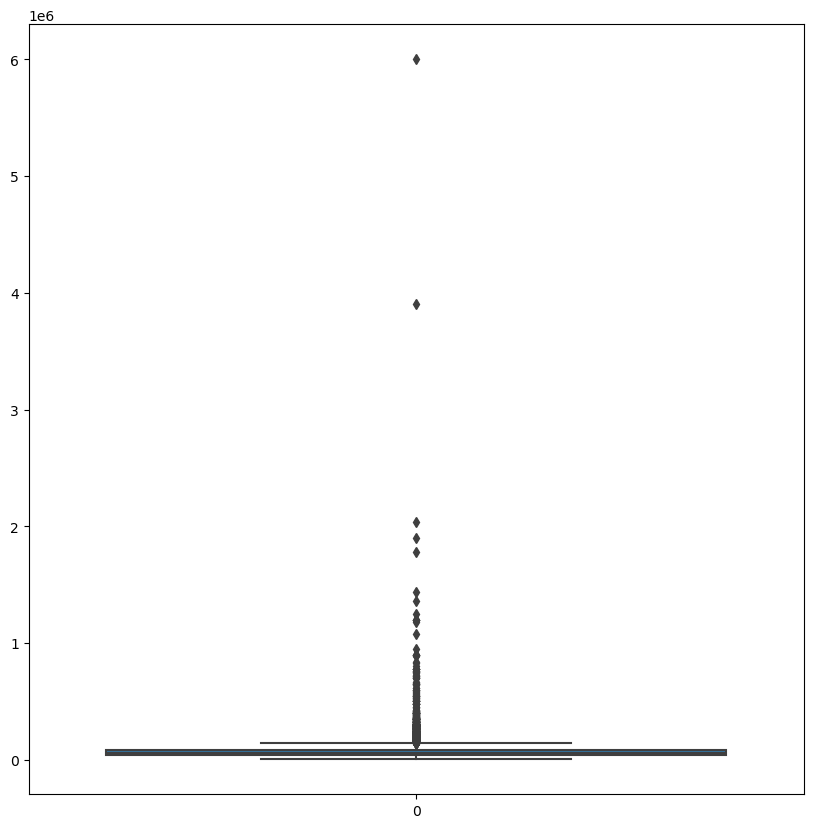

In [45]:
#box plot for outlier detection with Annual Income
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.annual_inc)

In [46]:
loan_data.annual_inc.describe()

count    3.852400e+04
mean     6.880830e+04
std      6.421626e+04
min      4.000000e+03
25%      4.000000e+04
50%      5.900000e+04
75%      8.200000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Remove the rows with annual income above .95 in quantile_*

<Axes: >

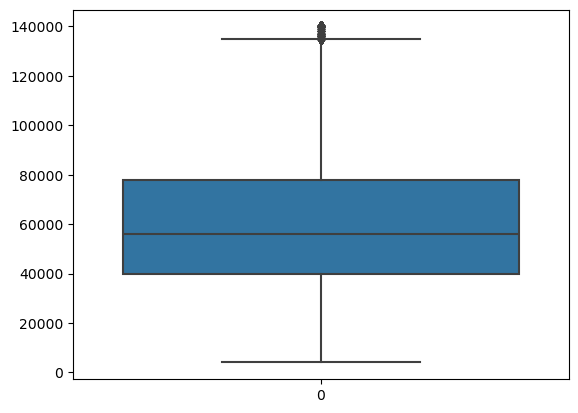

In [48]:
## Remove the rows with annual income above .95 in quantile
ninety_five_perc=loan_data.annual_inc.quantile(0.95)
loan_data=loan_data[loan_data.annual_inc<ninety_five_perc]
sns.boxplot(loan_data.annual_inc)

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Box plot for outlier detection with loan amount_*
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.loan_amnt)

In [50]:
loan_data.loan_amnt.quantile([.5,.75,.9,.95,.99])

0.50     9250.0
0.75    15000.0
0.90    20000.0
0.95    25000.0
0.99    35000.0
Name: loan_amnt, dtype: float64

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Remove the rows with loan amount above .95 in quantile_*

In [52]:
## Remove the rows with loan amount above .95 in quantile
loan_data=loan_data[loan_data.loan_amnt<=loan_data.loan_amnt.quantile(.95)]

<Axes: >

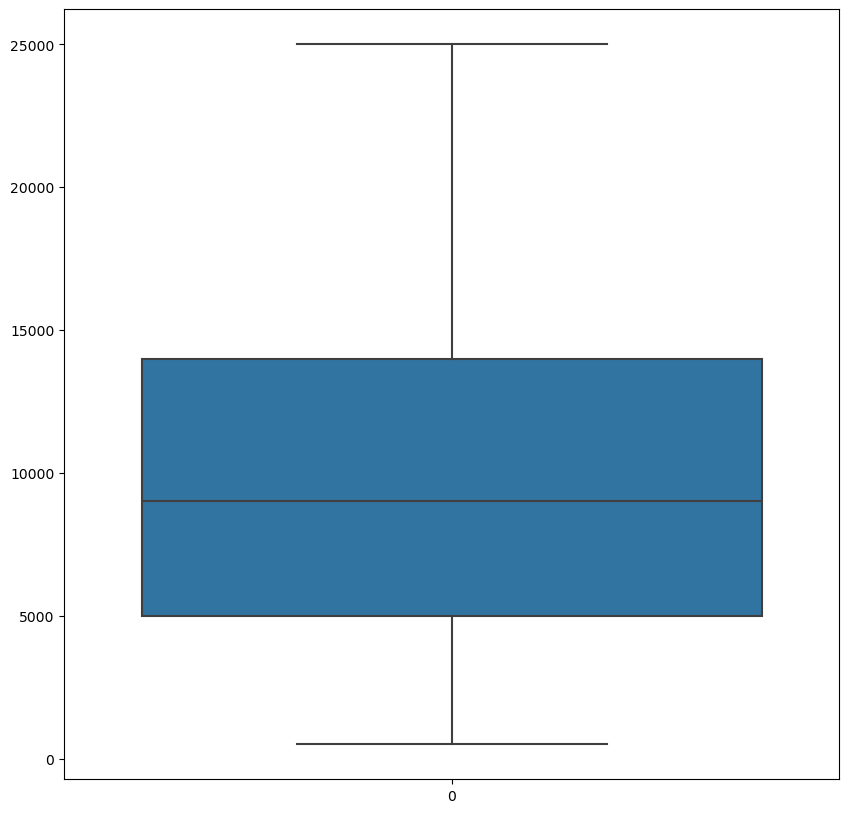

In [53]:
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.loan_amnt)

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Box plot for outlier detection with funded amount_*

In [55]:
## box plot for outlier detection with funded Amount
loan_data.funded_amnt.quantile([.5,.75,.9,.95,.99])

0.50     8850.0
0.75    13600.0
0.90    19000.0
0.95    21000.0
0.99    25000.0
Name: funded_amnt, dtype: float64

<Axes: >

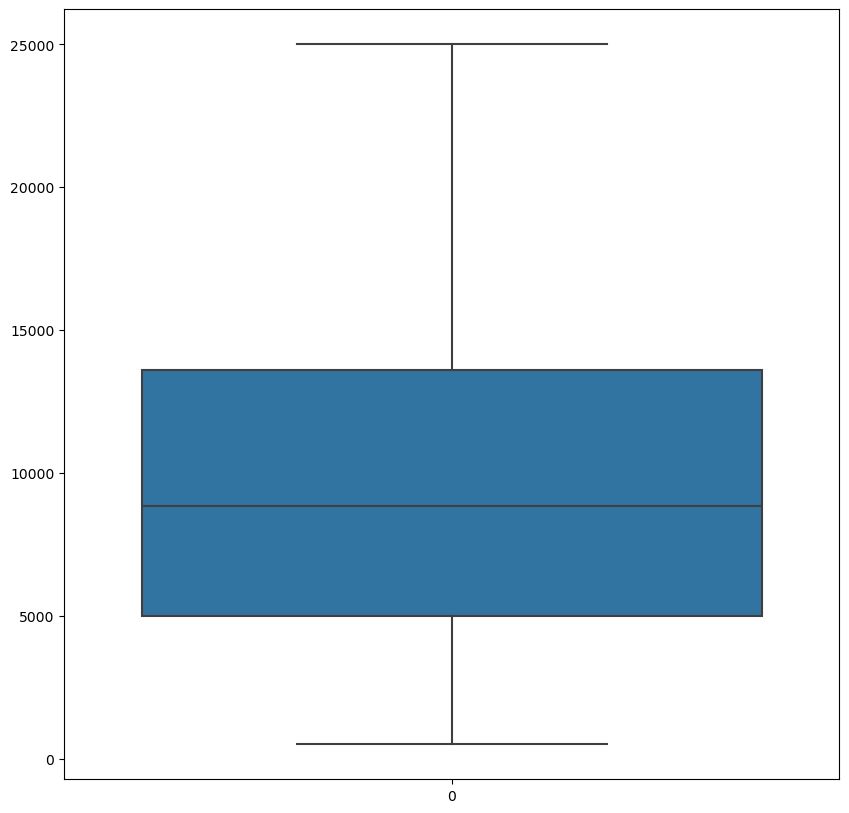

In [56]:
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.funded_amnt)

*__No outliers found, so no need to remove any rows for funded amount.__*

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Box plot for outlier detection with Interest Rate_*

<Axes: >

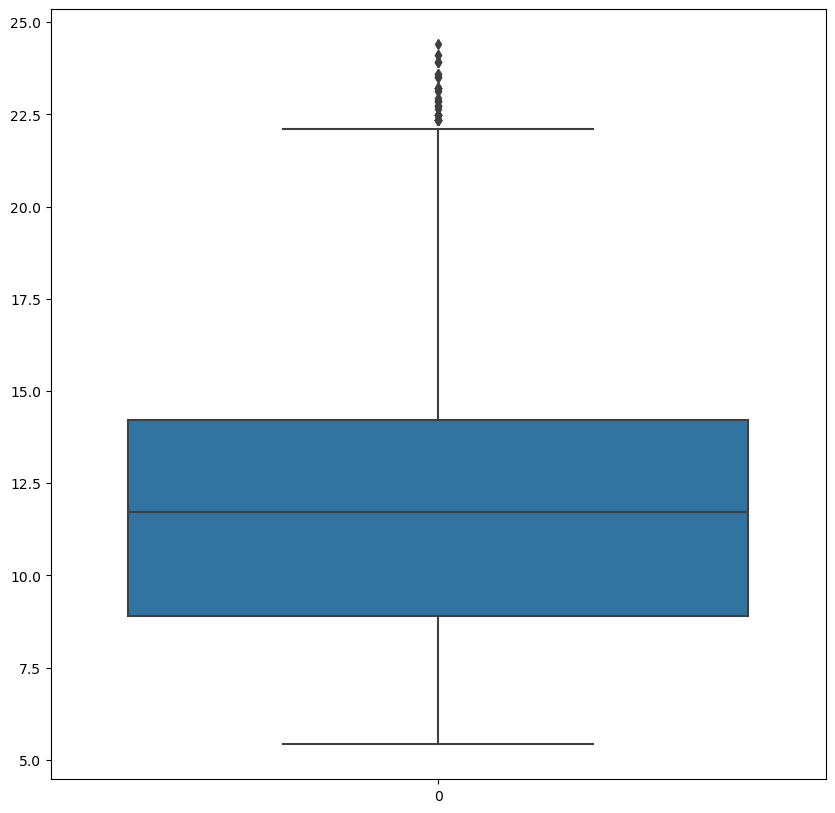

In [59]:
## box plot for outlier detection with Interest Rat
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.int_rate)

# <span style="background-color: lightblue;text-align: center;font-size: 18px;">*_Box plot for outlier detection with Total Payment_*

<Axes: >

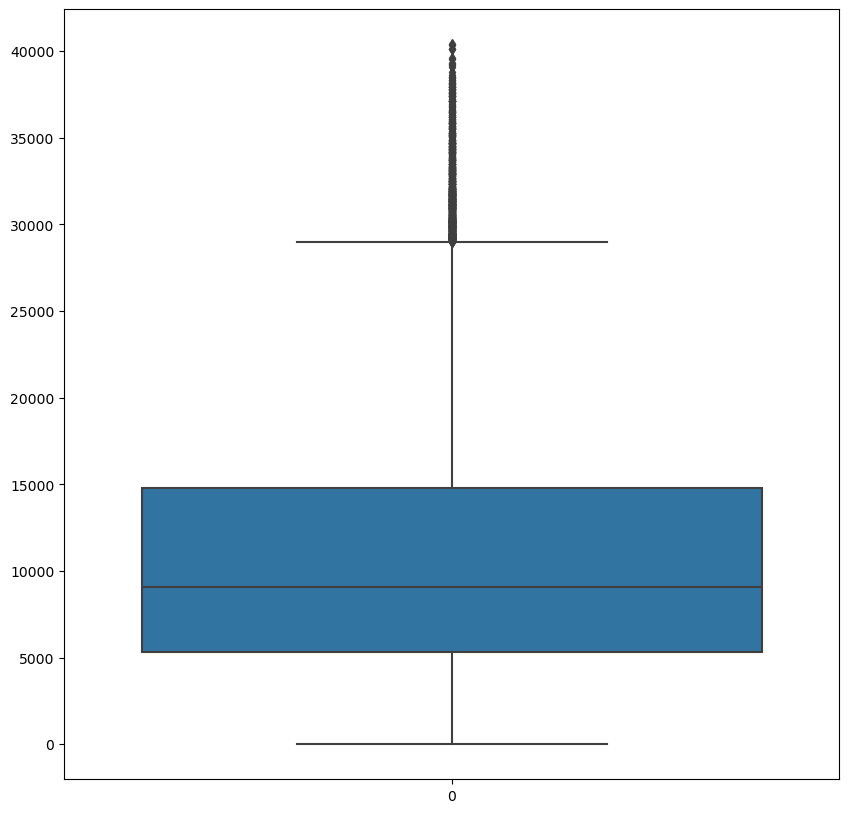

In [61]:
## box plot for outlier detection with Total Payment
plt.figure(figsize=(10,10))
sns.boxplot(loan_data.total_pymnt)

# <span style="background-color: yellow;text-align: center;">*_LOAN STATUS [PAID VS CHARGED OFF] VIEW_*   

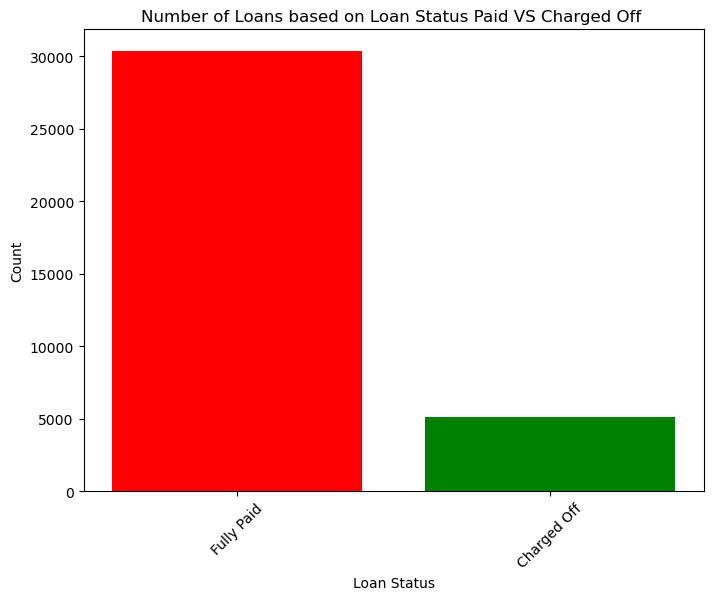

In [63]:
loan_status_counts = loan_data['loan_status'].value_counts()
categories = loan_status_counts.index
values = loan_status_counts.values
plt.figure(figsize=(8, 6))  
plt.bar(categories, values,color=['red','green'])
plt.xlabel('Loan Status')
plt.ylabel('Count')
plt.title('Number of Loans based on Loan Status Paid VS Charged Off ')
plt.xticks(rotation=45) 
plt.show()


# <span style="background-color: yellow;text-align: center;">*HEAT MAP WITH ALL NUMERIC VALUES*   

In [65]:
col_data_type=loan_data.select_dtypes(include=["int64","float64"])
col_data_type

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,emp_length,annual_inc,dti,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_pymnt,last_pymnt_amnt,pub_rec_bankruptcies
0,5000,5000,4975.000000,10.65,162.87,10,24000.00,27.65,1,3,0,13648,83.70,5863.155187,171.62,0.0
1,2500,2500,2500.000000,15.27,59.83,1,30000.00,1.00,5,3,0,1687,9.40,1008.710000,119.66,0.0
2,2400,2400,2400.000000,15.96,84.33,10,12252.00,8.72,2,2,0,2956,98.50,3005.666844,649.91,0.0
3,10000,10000,10000.000000,13.49,339.31,10,49200.00,20.00,1,10,0,5598,21.00,12231.890000,357.48,0.0
5,5000,5000,5000.000000,7.90,156.46,3,36000.00,11.20,3,9,0,7963,28.30,5632.210000,161.03,0.0
6,7000,7000,7000.000000,15.96,170.08,8,47004.00,23.51,1,7,0,17726,85.60,10110.840000,1313.76,0.0
7,3000,3000,3000.000000,18.64,109.43,9,48000.00,5.35,2,4,0,8221,87.50,3939.135294,111.34,0.0
8,5600,5600,5600.000000,21.28,152.39,4,40000.00,5.55,2,11,0,5210,32.60,646.020000,152.39,0.0
9,5375,5375,5350.000000,12.69,121.45,1,15000.00,18.08,0,2,0,9279,36.50,1476.190000,121.45,0.0
10,6500,6500,6500.000000,14.65,153.45,5,72000.00,16.12,2,14,0,4032,20.60,7678.017673,1655.54,0.0


<Axes: >

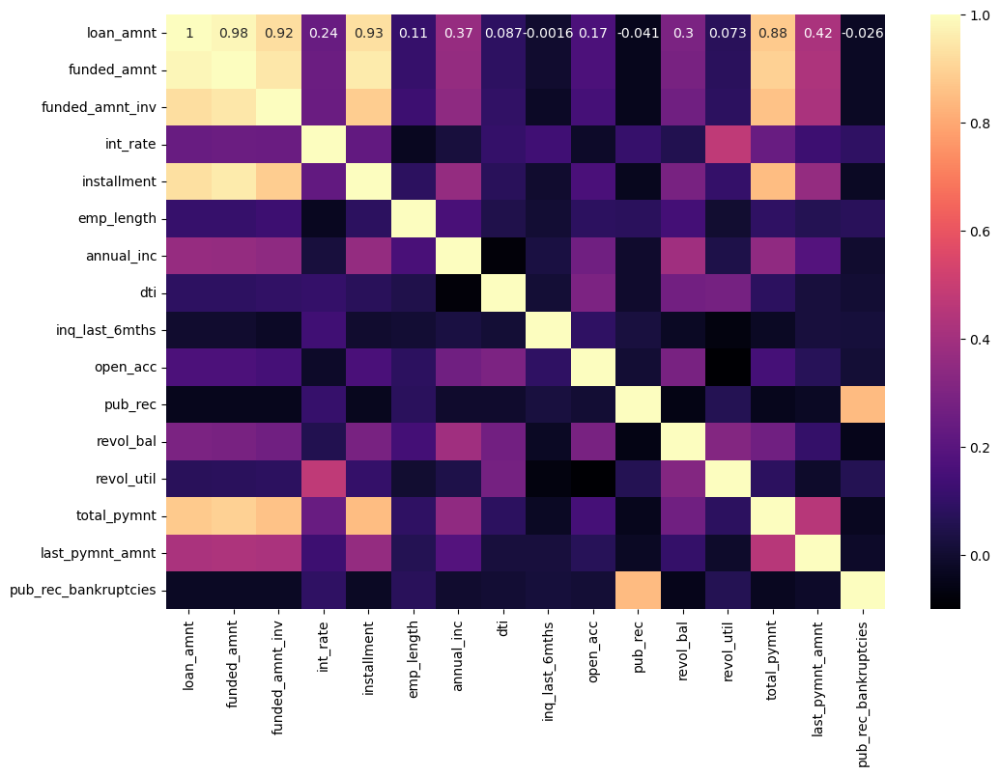

In [66]:
plt.figure(figsize=(12, 8))
sns.heatmap(col_data_type.corr(), annot=True, cmap='magma')

# <span style="background-color: yellow;text-align: center;">*_Univariate Analysis_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_UNIVARIATE ANALYSIS WITH ALL AMOUNT DATA-LOAN AMOUNT,FUNDED AMOUNT,ANNUAL INCOME,TOTAL PAYMENT_*


In [68]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35475 entries, 0 to 39716
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             35475 non-null  int64  
 1   funded_amnt           35475 non-null  int64  
 2   funded_amnt_inv       35475 non-null  float64
 3   term                  35475 non-null  object 
 4   int_rate              35475 non-null  float64
 5   installment           35475 non-null  float64
 6   grade                 35475 non-null  object 
 7   sub_grade             35475 non-null  object 
 8   emp_title             35475 non-null  object 
 9   emp_length            35475 non-null  int64  
 10  home_ownership        35475 non-null  object 
 11  annual_inc            35475 non-null  float64
 12  verification_status   35475 non-null  object 
 13  issue_d               35475 non-null  object 
 14  loan_status           35475 non-null  object 
 15  purpose               35

[Text(0.5, 1.0, 'Distribution plot for Total Payment'),
 Text(0.5, 0, 'Total Payment')]

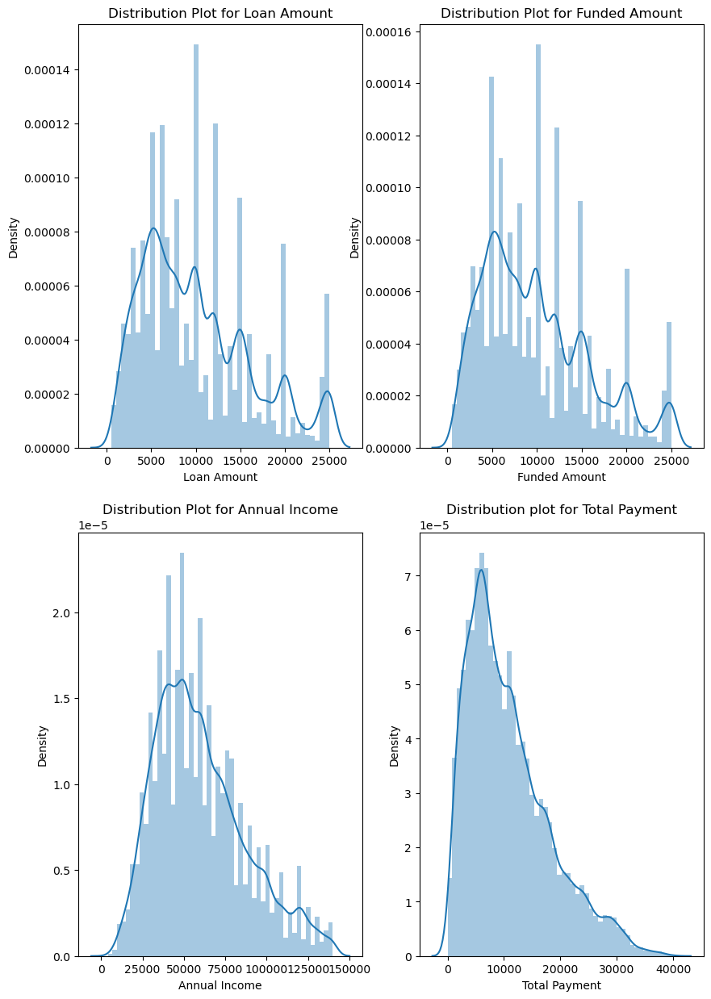

In [69]:
plt.figure(figsize=(10,15))

plt.subplot(2,2,1)
axis_1=sns.distplot(loan_data.loan_amnt)
axis_1.set(title='Distribution Plot for Loan Amount',xlabel='Loan Amount')

plt.subplot(2,2,2)
axis_1=sns.distplot(loan_data.funded_amnt)
axis_1.set(title='Distribution Plot for Funded Amount',xlabel='Funded Amount')

plt.subplot(2,2,3)
axis_1=sns.distplot(loan_data.annual_inc)
axis_1.set(title='Distribution Plot for Annual Income',xlabel='Annual Income')

plt.subplot(2,2,4)
axis_1=sns.distplot(round(loan_data.total_pymnt))
axis_1.set(title='Distribution plot for Total Payment', xlabel='Total Payment')




### **_Observations_**
#### *_The amount distributions for all four amount categories exhibit a comparable shape &  show a high degree of similarity._*

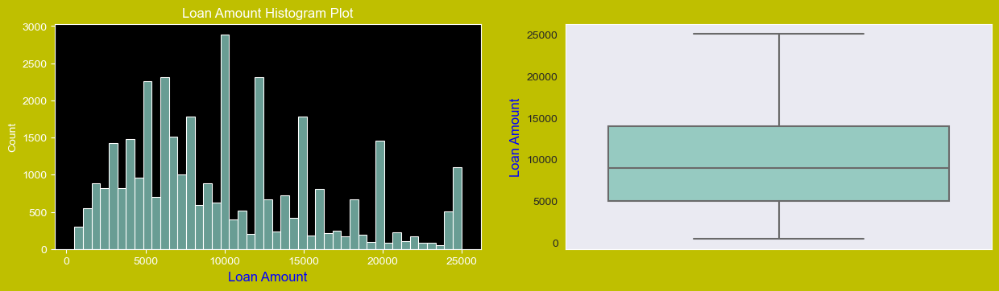

In [71]:
with plt.style.context('dark_background'):
  plt.figure(figsize=(15,8),facecolor='y')
  
  #Subplot 1

  plt.subplot(2,2,1)
  ax=sns.histplot(loan_data.loan_amnt)
  ax.set(title='Loan Amount Histogram Plot')
  ax.set_xlabel('Loan Amount', fontsize=12,color='b')

  #Subplot 2
  sns.set_style("dark")

  plt.subplot(2,2,2)
  ax=sns.boxplot(y=loan_data.loan_amnt)
  ax.set_ylabel('Loan Amount', fontsize=12,color='b')
  plt.show()

### **_Observations_**
#### *_The majority of loan amounts fall within the range of 5000 to 15000_*

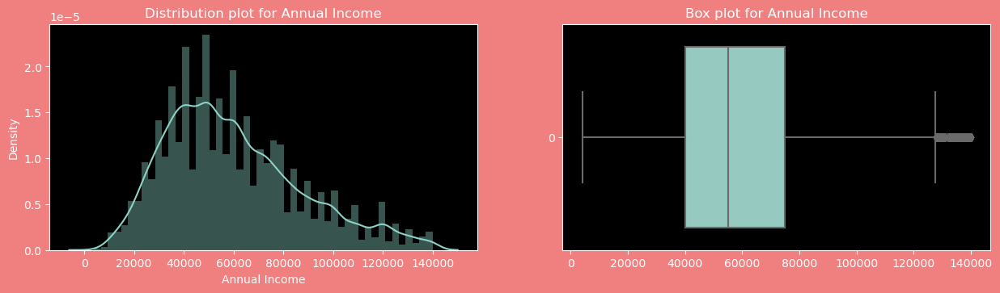

In [73]:
with plt.style.context('dark_background'):
    plt.figure(figsize=(15,8),facecolor='lightcoral')
    plt.subplot(2,2,1)
    axis1=sns.distplot(loan_data.annual_inc)
    axis1.set(title='Distribution plot for Annual Income',xlabel='Annual Income')
    plt.subplot(2,2,2)
    axis1=sns.boxplot(loan_data.annual_inc ,orient='h')
    axis1.set(title='Box plot for Annual Income')
    

### **_Observations_**
#### *_The majority of Annual Income fall within the range of 40000 to 80000_*

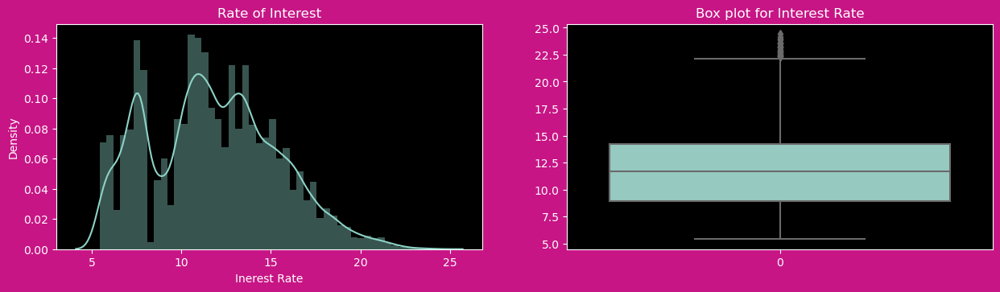

In [75]:
with plt.style.context('dark_background'):
    plt.figure(figsize=(15,8),facecolor='mediumvioletred')
    plt.subplot(2,2,1)
    axis1=sns.distplot(loan_data.int_rate)
    axis1.set(title='Rate of Interest',xlabel='Inerest Rate')
    plt.subplot(2,2,2)
    axis1=sns.boxplot(loan_data.int_rate)
    axis1.set(title='Box plot for Interest Rate')

### **_Observations_**
#### *_The majority of Interest Rate between 9-14%_*

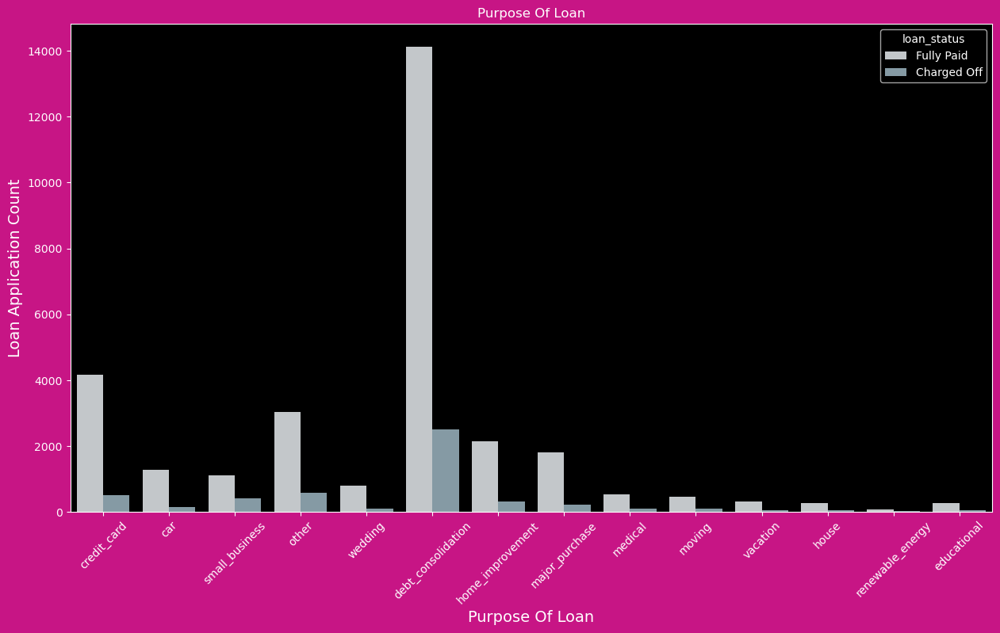

In [77]:
with plt.style.context('dark_background'):
  plt.figure(figsize=(15,8),facecolor='mediumvioletred')
  ax=sns.countplot(x="purpose",data=loan_data,hue='loan_status',palette='RdBu_d')
  plt.xticks(rotation=45)
  ax.set(title='Purpose Of Loan')
  ax.set_xlabel('Purpose Of Loan',fontsize=14,color='w')
  ax.set_ylabel('Loan Application Count',fontsize=14,color='w')
   
    

### **_Observations_**
#### *_The count plot shows that debt consolidation accounted for the majority of loans taken out._*
#### *_Furthermore, a very high number of loans that have been charged off are connected to these uses._*

# <span style="background-color: yellow;text-align: center;">*_Bivariate Analysis_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_The table below shows the correlation matrix for numerical variables:_*

In [80]:
correlation_matrix=col_data_type.corr()
correlation_matrix

,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,emp_length,annual_inc,dti,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_pymnt,last_pymnt_amnt,pub_rec_bankruptcies
loan_amnt,1.000000,0.981060,0.924873,0.241450,0.928246,0.110294,0.368264,0.086928,-0.001628,0.166380,-0.040709,0.295374,0.072900,0.875682,0.419972,-0.026384
funded_amnt,0.981060,1.000000,0.944264,0.251229,0.954807,0.110011,0.364333,0.086331,-0.001221,0.163865,-0.040230,0.286683,0.077758,0.892701,0.425429,-0.025978
funded_amnt_inv,0.924873,0.944264,1.000000,0.245900,0.886034,0.126313,0.345347,0.095922,-0.017992,0.149126,-0.041641,0.264074,0.082883,0.861045,0.417836,-0.026109
int_rate,0.241450,0.251229,0.245900,1.000000,0.226234,-0.031154,0.024156,0.105412,0.134716,-0.016995,0.108231,0.058633,0.472910,0.242372,0.127357,0.090654
installment,0.928246,0.954807,0.886034,0.226234,1.000000,0.081019,0.362961,0.074022,-0.001536,0.158672,-0.035835,0.283840,0.104450,0.848514,0.360497,-0.023262
emp_length,0.110294,0.110011,0.126313,-0.031154,0.081019,1.000000,0.154535,0.048920,0.007503,0.084088,0.076749,0.144016,-0.000403,0.092368,0.060667,0.076504
annual_inc,0.368264,0.364333,0.345347,0.024156,0.362961,0.154535,1.000000,-0.078702,0.029746,0.262607,-0.005647,0.390460,0.045519,0.349981,0.186767,-0.002586
dti,0.086928,0.086331,0.095922,0.105412,0.074022,0.048920,-0.078702,1.000000,0.008595,0.296397,-0.006820,0.267249,0.275141,0.082532,0.023270,0.005082
inq_last_6mths,-0.001628,-0.001221,-0.017992,0.134716,-0.001536,0.007503,0.029746,0.008595,1.000000,0.091828,0.027281,-0.025319,-0.066805,-0.023131,0.021501,0.016735
open_acc,0.166380,0.163865,0.149126,-0.016995,0.158672,0.084088,0.262607,0.296397,0.091828,1.000000,0.006138,0.284921,-0.099466,0.147744,0.070902,0.010588


### **_Observations_**
##### 1.*_Loan amount, funding amount, and funded amount invested are strongly correlated: These three variables are closely related, indicating that as one increases, mthe others tend to increase as well._*
##### 2. *_Interest rate and employee length are negatively correlated: This suggests that longer employee tenure is associated with lower interest rates, possibly reflecting lower risk for long-term employed individuals._*
##### 3. *_Delinquency in the past 2 years and inquiries in the last 6 months are positively correlated with the interest rate: This suggests a tendency towards higher interest rates for borrowers with recent delinquencies and numerous recent credit inquiries, indicating a higher risk of default._*
##### 4. *_Annual income is positively correlated with loan amount, revol_bal, and total payment: Higher income individuals tend to take out larger loans, have higher revolving balances, and make higher total payments._*
##### 5. *_Debt-to-income (DTI) ratio is positively correlated with revolving balance: This indicates that individuals with higher revolving balances tend to have higher debt-to-income ratios._*
##### 6. *_Total payment is strongly corremlated with loan amount, funded amount, and funded amount investedm: This shows that larger loans lead to higher total payments over time._*

# <span style="background-color: yellow;text-align: center;">*_Correlation analysis_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_Selecting relevant columns for correlation analysis:_*

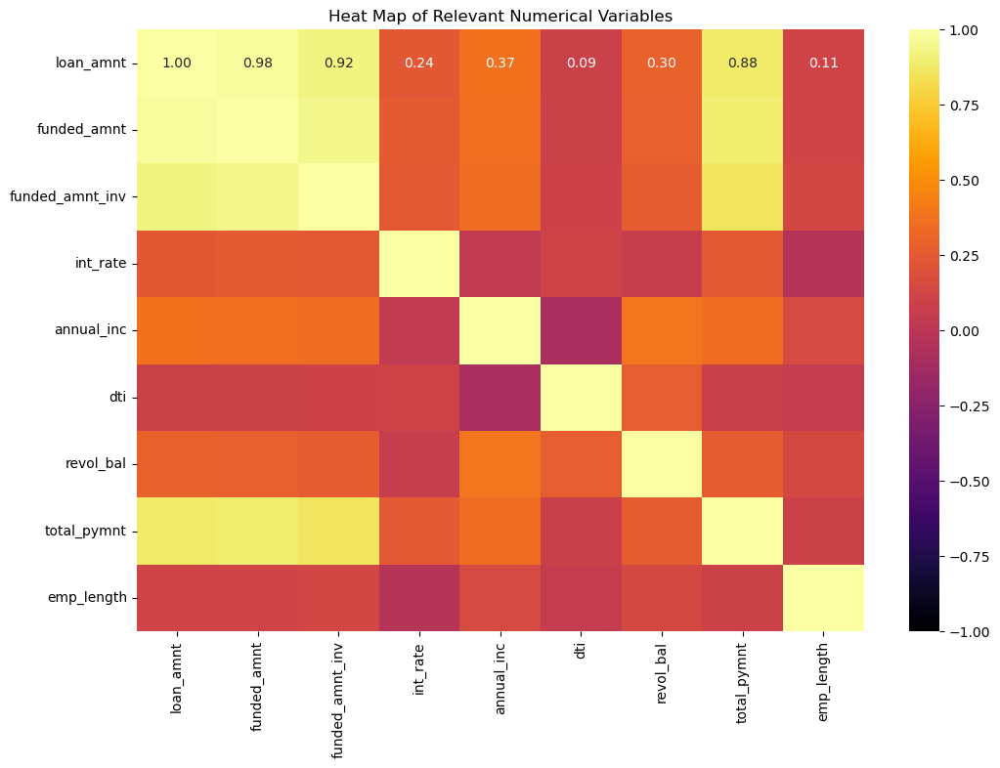

In [83]:

# Selecting relevant columns for correlation analysis
selected_columns = ['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'int_rate', 'annual_inc', 'dti', 'revol_bal', 'total_pymnt', 'emp_length']
loan_data_selected = loan_data[selected_columns]
# Calculate the correlation matrix for the selected columns
correlation_matrix = loan_data_selected.corr()

# Get the correlation of int_rate with other columns
int_rate_correlation = correlation_matrix['int_rate'].sort_values(ascending=False)

# Display the correlation matrix and the int_rate correlations
correlation_matrix, int_rate_correlation
plt.figure(figsize=(12, 8))
ax=sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='inferno', vmin=-1, vmax=1)
ax.set_title("Heat Map of Relevant Numerical Variables")
plt.show()

In [84]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35475 entries, 0 to 39716
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             35475 non-null  int64  
 1   funded_amnt           35475 non-null  int64  
 2   funded_amnt_inv       35475 non-null  float64
 3   term                  35475 non-null  object 
 4   int_rate              35475 non-null  float64
 5   installment           35475 non-null  float64
 6   grade                 35475 non-null  object 
 7   sub_grade             35475 non-null  object 
 8   emp_title             35475 non-null  object 
 9   emp_length            35475 non-null  int64  
 10  home_ownership        35475 non-null  object 
 11  annual_inc            35475 non-null  float64
 12  verification_status   35475 non-null  object 
 13  issue_d               35475 non-null  object 
 14  loan_status           35475 non-null  object 
 15  purpose               35

# <span style="background-color: yellow;text-align: center;">*_Bi variate Analysis-With loan status_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_In this section, we will compare the loan status to certain important columns that might have an impact on debts that have been charged off._*
* LOAN AMOUNT
* INTEREST RATE
* ANNUAL INCOME
* PURPOSE OF LOAN
* GRADE
* SUB GRADE
* EMP LENGTH (EMPLOYEE EXPERIENCE)
* VERIFICATION STATUS
* ADDRESS STATE
* PUB_REC_BANKRUPTICIES (BANKRUPTICIES)


In [86]:
loan_data.loan_amnt.describe()

count    35475.000000
mean     10037.187456
std       6079.154865
min        500.000000
25%       5000.000000
50%       9000.000000
75%      14000.000000
max      25000.000000
Name: loan_amnt, dtype: float64

In [87]:
#Bin Creation for loan amount with 6 bins with 5000 intervals
loan_data["loan_amnt_cat"]=pd.cut(loan_data.loan_amnt,[0,5000,10000,15000,20000,25000],labels=['0-5000','5000-10000','10000-15000','15000-20000','20000-25000'])
loan_data["loan_amnt_cat"]
loan_amnt_vs_status = loan_data.groupby(['loan_amnt_cat', 'loan_status']).loan_status.count().unstack().fillna(0).reset_index()
loan_amnt_vs_status['Total'] = loan_amnt_vs_status['Charged Off'] + loan_amnt_vs_status['Fully Paid']
loan_amnt_vs_status['Chargedoff_Proportion'] = round(loan_amnt_vs_status['Charged Off'] / loan_amnt_vs_status['Total'],2)
loan_amnt_vs_status.sort_values(by='Chargedoff_Proportion')


loan_status,loan_amnt_cat,Charged Off,Fully Paid,Total,Chargedoff_Proportion
1,5000-10000,1600,10807,12407,0.13
0,0-5000,1290,7993,9283,0.14
2,10000-15000,1027,6297,7324,0.14
3,15000-20000,721,3329,4050,0.18
4,20000-25000,485,1926,2411,0.20


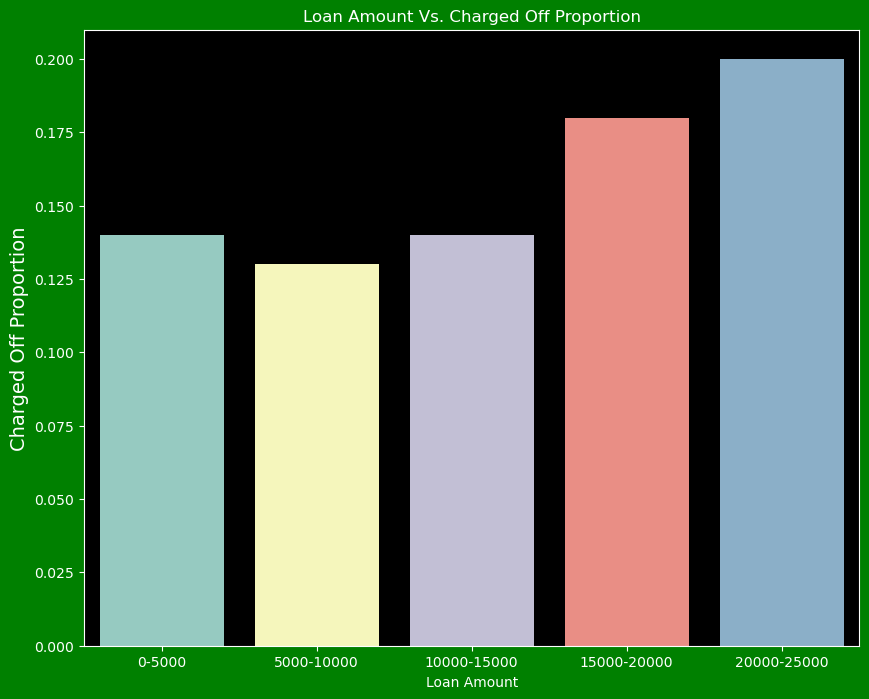

In [88]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='GREEN')
  ax.set(title='Loan Amount Vs. Charged Off Proportion')
  ax=sns.barplot(x='loan_amnt_cat',y='Chargedoff_Proportion',data=loan_amnt_vs_status)
  ax.set_xlabel('Loan Amount',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.show()

### **_Observations_**
#### *_Loans between 20,000 and 25,000 are more likely to be charged off than loans between 0 and 10,000._* 
#### *_Notably, as loan amounts increase, so does the proportion of charged-off loans, demonstrating a clear proportional relationship._*

In [90]:
loan_data.int_rate.describe()

count    35475.000000
mean        11.766285
std          3.591897
min          5.420000
25%          8.900000
50%         11.710000
75%         14.220000
max         24.400000
Name: int_rate, dtype: float64

In [91]:
#Bin Creation for interest rate with 5 bins with 5 intervals
loan_data["int_rat_cat"]=pd.cut(loan_data.int_rate,[5,10,15,20,25],labels=['5-10','10-15','15-20','20-25'])
loan_data["int_rat_cat"]
int_rat_vs_status = loan_data.groupby(['int_rat_cat', 'loan_status']).int_rate.count().unstack().fillna(0).reset_index()
int_rat_vs_status['Total'] = int_rat_vs_status['Charged Off'] + int_rat_vs_status['Fully Paid']
int_rat_vs_status['Chargedoff_Proportion'] = round(int_rat_vs_status['Charged Off'] / int_rat_vs_status['Total'],2)
int_rat_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,int_rat_cat,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,5-10,808,10898,11706,0.07
1,10-15,2554,14431,16985,0.15
2,15-20,1557,4717,6274,0.25
3,20-25,204,306,510,0.40


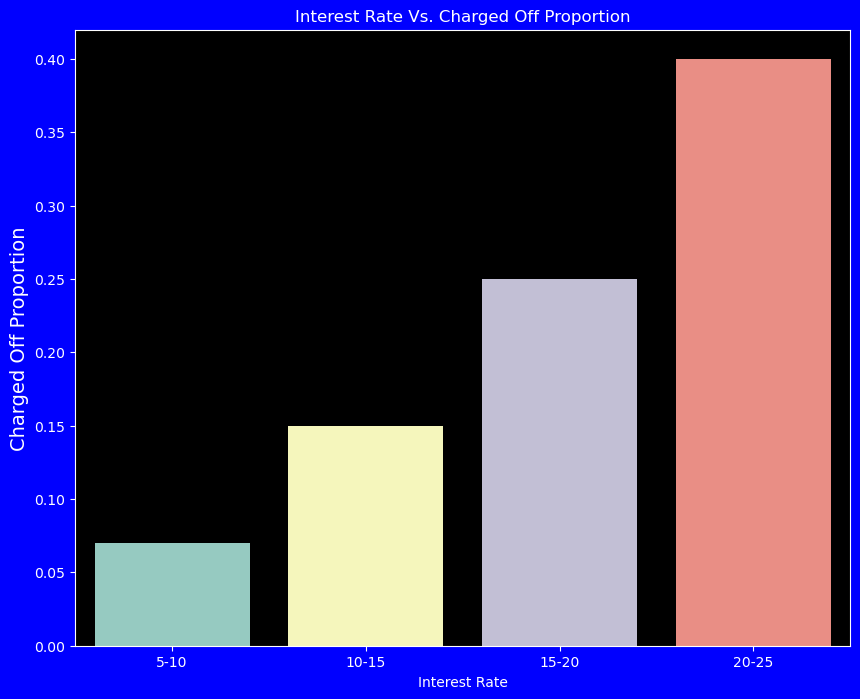

In [92]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='blue')
  ax.set(title='Interest Rate Vs. Charged Off Proportion')
  ax=sns.barplot(x='int_rat_cat',y='Chargedoff_Proportion',data=int_rat_vs_status)
  ax.set_xlabel('Interest Rate',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.show()

### **_Observations_**
#### *_Interest rates between 20% and 25% are more likely to result in charge-offs compared to those below 20%._* 
#### *_It's clear that as interest rates climb, the percentage of charged-off loans follows suit, showing a direct correlation._*

In [94]:
loan_data.annual_inc.describe()

count     35475.000000
mean      59956.140832
std       27321.667567
min        4000.000000
25%       40000.000000
50%       55000.000000
75%       75000.000000
max      140000.000000
Name: annual_inc, dtype: float64

In [95]:
#Bin Creation for annual income with 5 bins with 5 intervals
loan_data["annual_inc_cat"]=pd.cut(loan_data.annual_inc,[0,20000,40000,60000,80000,100000,120000,140000],labels=['0-20K','20-40K','40-60K','60-80K','80-100K','100-120K','120-140K'])
annual_inc_vs_status = loan_data.groupby(['annual_inc_cat', 'loan_status']).annual_inc.count().unstack().fillna(0).reset_index()
annual_inc_vs_status['Total'] = annual_inc_vs_status['Charged Off'] + annual_inc_vs_status['Fully Paid']
annual_inc_vs_status['Chargedoff_Proportion'] = round(annual_inc_vs_status['Charged Off'] / annual_inc_vs_status['Total'],2)
annual_inc_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,annual_inc_cat,Charged Off,Fully Paid,Total,Chargedoff_Proportion
5,100-120K,198,1924,2122,0.09
4,80-100K,460,3740,4200,0.11
6,120-140K,116,956,1072,0.11
3,60-80K,934,6368,7302,0.13
2,40-60K,1676,9443,11119,0.15
1,20-40K,1506,6988,8494,0.18
0,0-20K,233,933,1166,0.20


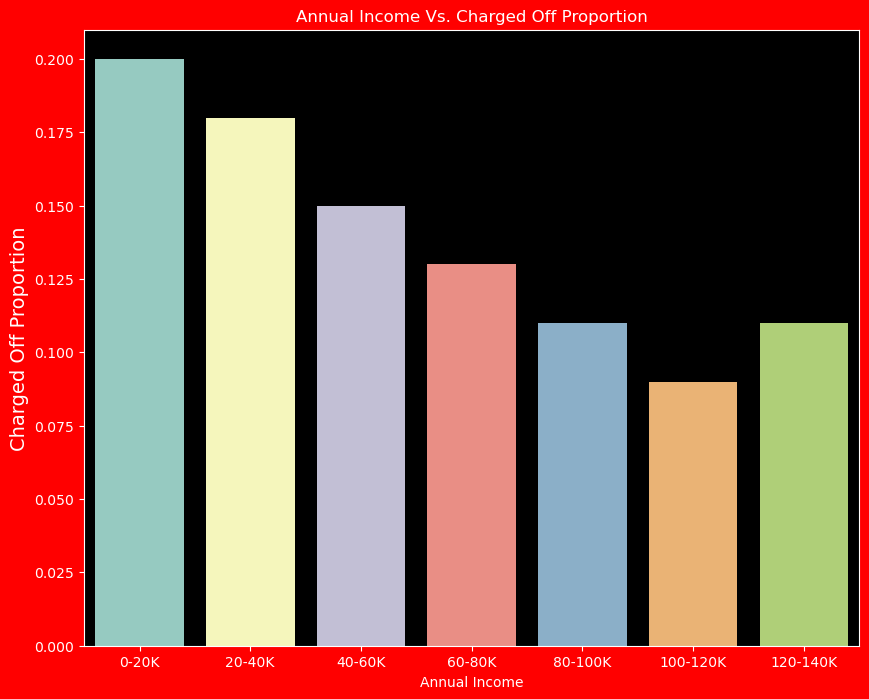

In [96]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='red')
  ax.set(title='Annual Income Vs. Charged Off Proportion')
  ax=sns.barplot(x='annual_inc_cat',y='Chargedoff_Proportion',data=annual_inc_vs_status)
  ax.set_xlabel('Annual Income',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.show()

### **_Observations_**
#### *_It's clear that as annual income increases, the percentage of charged-off loans decreases, showing a negative correlation._*

In [98]:
loan_data.purpose.describe()

count                  35475
unique                    14
top       debt_consolidation
freq                   16610
Name: purpose, dtype: object

In [99]:
purpose_vs_status = loan_data.groupby(['purpose', 'loan_status']).purpose.count().unstack().fillna(0).reset_index()
purpose_vs_status['Total'] = purpose_vs_status['Charged Off'] + purpose_vs_status['Fully Paid']
purpose_vs_status['Chargedoff_Proportion'] = round(purpose_vs_status['Charged Off'] / purpose_vs_status['Total'],2)
purpose_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,purpose,Charged Off,Fully Paid,Total,Chargedoff_Proportion
13,wedding,90,792,882,0.10
0,car,158,1286,1444,0.11
1,credit_card,498,4155,4653,0.11
6,major_purchase,214,1803,2017,0.11
4,home_improvement,305,2149,2454,0.12
12,vacation,52,311,363,0.14
2,debt_consolidation,2497,14113,16610,0.15
5,house,51,271,322,0.16
7,medical,100,533,633,0.16
8,moving,89,457,546,0.16


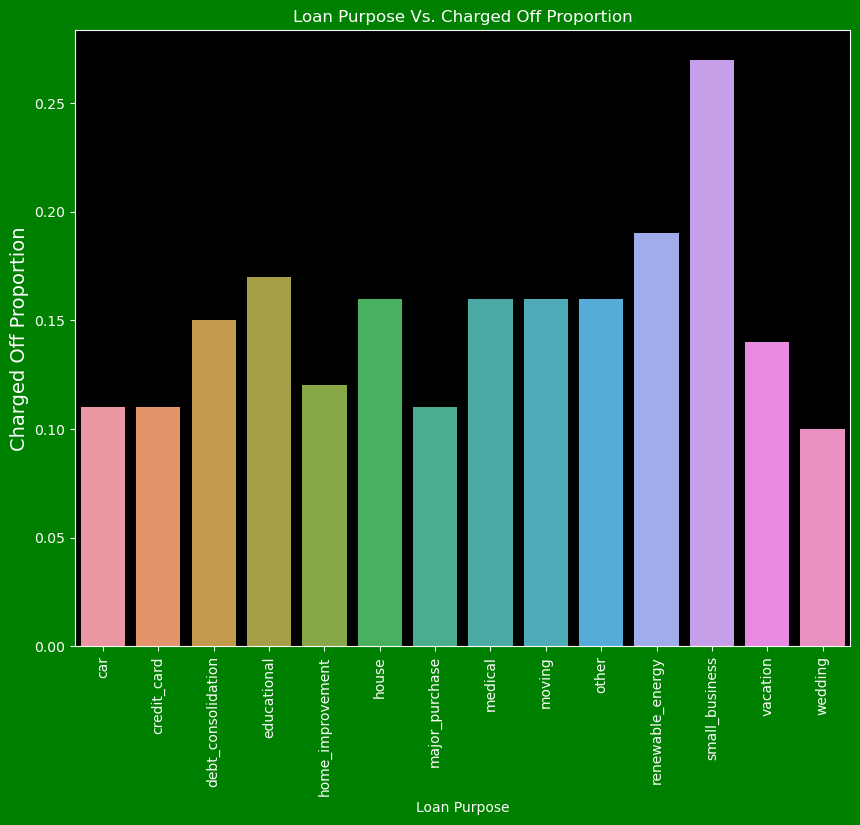

In [100]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='green')
  ax.set(title='Loan Purpose Vs. Charged Off Proportion')
  ax=sns.barplot(x='purpose',y='Chargedoff_Proportion',data=purpose_vs_status)
  ax.set_xlabel('Loan Purpose',fontsize=10,color='w')
  plt.xticks(rotation=90)
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.show()

### **_Observations_**
#### Analysis of Loan Default Proportions vs Loan Purpose
#### *_Small business loans are at a higher proportion of charged off loans._*
#### *_Wedding loans have the least proportion of charged off loans._*

In [102]:
loan_data.grade.describe()

count     35475
unique        7
top           B
freq      10861
Name: grade, dtype: object

In [103]:
grade_vs_status = loan_data.groupby(['grade', 'loan_status']).grade.count().unstack().fillna(0).reset_index()
grade_vs_status['Total'] = grade_vs_status['Charged Off'] + grade_vs_status['Fully Paid']
grade_vs_status['Chargedoff_Proportion'] = round(grade_vs_status['Charged Off'] / grade_vs_status['Total'],2)
grade_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,grade,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,A,590,8966,9556,0.06
1,B,1339,9522,10861,0.12
2,C,1278,6008,7286,0.18
3,D,1027,3619,4646,0.22
4,E,573,1585,2158,0.27
5,F,238,512,750,0.32
6,G,78,140,218,0.36


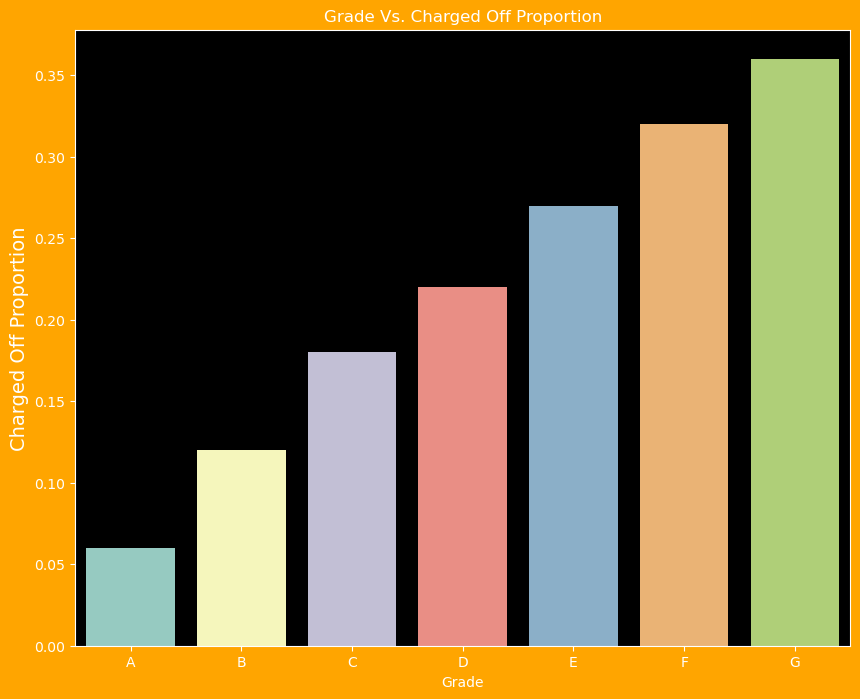

In [104]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='orange')
  ax.set(title='Grade Vs. Charged Off Proportion')
  ax=sns.barplot(x='grade',y='Chargedoff_Proportion',data=grade_vs_status)
  ax.set_xlabel('Grade',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.show()

### **_Observations_**
#### Analysis of Loan Default Proportions vs Grade

* *Loans with Grade A have the lowest risk of being charged off.*
* *Loans with Grade F and Grade G have the highest risk of being charged off.*
* *The likelihood of a loan being charged off increases progressively from Grade A to Grade G.*


In [106]:
loan_data.sub_grade.describe()

count     35475
unique       35
top          A4
freq       2705
Name: sub_grade, dtype: object

In [107]:
sub_grade_vs_status = loan_data.groupby(['sub_grade', 'loan_status']).sub_grade.count().unstack().fillna(0).reset_index()
sub_grade_vs_status['Total'] = sub_grade_vs_status['Charged Off'] + sub_grade_vs_status['Fully Paid']
sub_grade_vs_status['Chargedoff_Proportion'] = round(sub_grade_vs_status['Charged Off'] / sub_grade_vs_status['Total'],2)
sub_grade_vs_status.sort_values(by='Chargedoff_Proportion')


loan_status,sub_grade,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,A1,30,1067,1097,0.03
1,A2,73,1370,1443,0.05
2,A3,102,1639,1741,0.06
3,A4,172,2533,2705,0.06
4,A5,213,2357,2570,0.08
5,B1,165,1526,1691,0.10
6,B2,215,1662,1877,0.11
7,B3,311,2269,2580,0.12
9,B5,338,2093,2431,0.14
8,B4,310,1972,2282,0.14


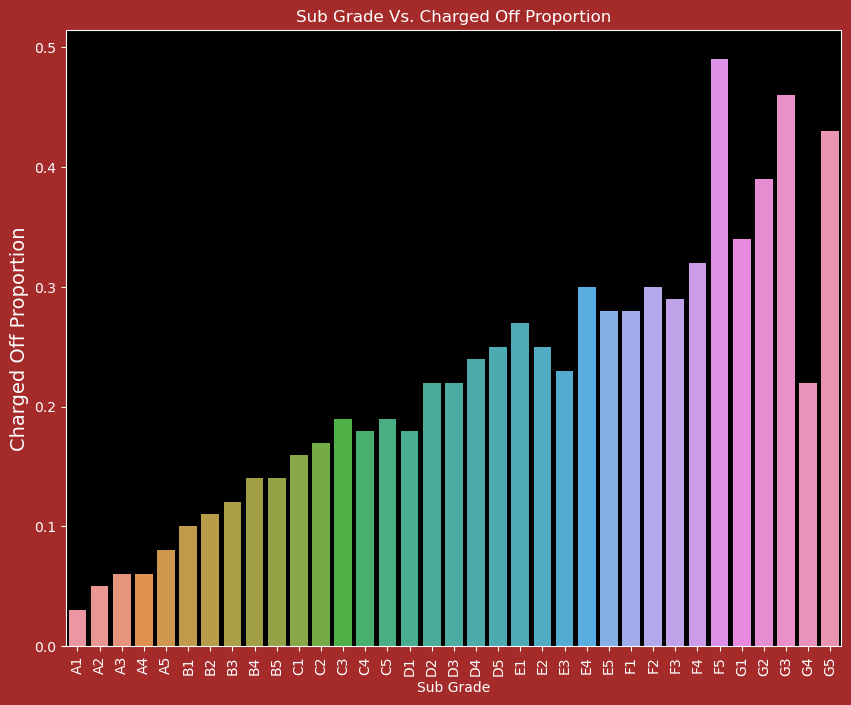

In [108]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='brown')
  ax.set(title='Sub Grade Vs. Charged Off Proportion')
  ax=sns.barplot(x='sub_grade',y='Chargedoff_Proportion',data=sub_grade_vs_status)
  ax.set_xlabel('Sub Grade',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')
  plt.xticks(rotation=90)
  plt.show()

### **_Observations_**
#### Analysis of Loan Default Proportions vs Sub Grade

* *Loans with Sub Grade A have the lowest risk of being charged off.*
* *Loans with Sub Grade F and Sub Grade G have the highest risk of being charged off.*
* *The likelihood of a loan being charged off increases progressively from Sub Grade A to Sub Grade G.*

loan_data.emp_length.describe()

In [110]:
emp_len_vs_status=loan_data.groupby(["emp_length","loan_status"]).emp_length.count().unstack().fillna(0).reset_index()
emp_len_vs_status["Total"]=emp_len_vs_status["Charged Off"]+emp_len_vs_status["Fully Paid"]
emp_len_vs_status['Chargedoff_Proportion'] = round(emp_len_vs_status['Charged Off'] / emp_len_vs_status['Total'],2)
emp_len_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,emp_length,Charged Off,Fully Paid,Total,Chargedoff_Proportion
1,2,525,3495,4020,0.13
8,9,143,983,1126,0.13
0,1,1029,6192,7221,0.14
2,3,513,3224,3737,0.14
3,4,422,2684,3106,0.14
4,5,421,2526,2947,0.14
5,6,280,1725,2005,0.14
7,8,184,1103,1287,0.14
6,7,238,1352,1590,0.15
9,10,1368,7068,8436,0.16


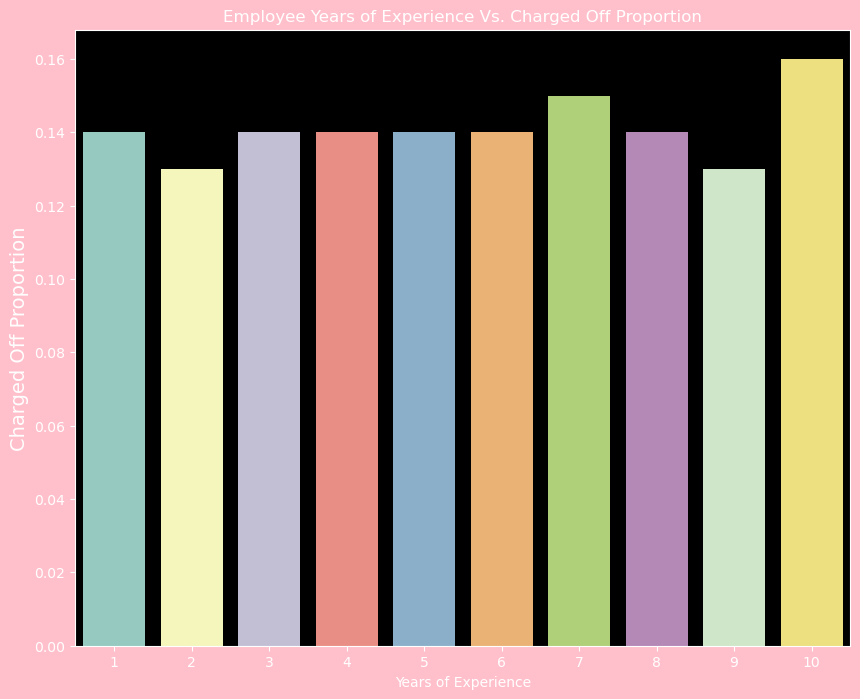

In [111]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='pink')
  ax.set(title='Employee Years of Experience Vs. Charged Off Proportion')
  ax=sns.barplot(x='emp_length',y='Chargedoff_Proportion',data=emp_len_vs_status)
  ax.set_xlabel('Years of Experience',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')

### **_Observations_**
* *Those who are unemployed or have less than one year of experience are more likely to be charged off.*
* *It makes sense, given that they have little or no expertise and no source of income to repay the debt.*
* *The rest of the applicants have almost equal chances of being charged off.*


In [113]:
loan_data.dti.describe()

count    35475.000000
mean        13.409949
std          6.659378
min          0.000000
25%          8.310000
50%         13.520000
75%         18.680000
max         29.990000
Name: dti, dtype: float64

In [114]:
#Bin Creation for dti with 6 bins with 5 intervals
loan_data["loan_dti"]=pd.cut(loan_data.dti,[0,5,10,15,20,25,30],labels=['0-5','5-10','10-15','15-20','20-25','25-30'])
loan_data["loan_dti"]
dti_vs_status=loan_data.groupby(["loan_dti","loan_status"]).dti.count().unstack().fillna(0).reset_index()
dti_vs_status["Total"]=dti_vs_status["Charged Off"]+dti_vs_status["Fully Paid"]
dti_vs_status['Chargedoff_Proportion'] = round(dti_vs_status['Charged Off'] / dti_vs_status['Total'],2)
dti_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,loan_dti,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,0-5,543,3801,4344,0.12
1,5-10,900,6173,7073,0.13
5,25-30,76,497,573,0.13
2,10-15,1278,7618,8896,0.14
3,15-20,1257,6942,8199,0.15
4,20-25,1042,5185,6227,0.17


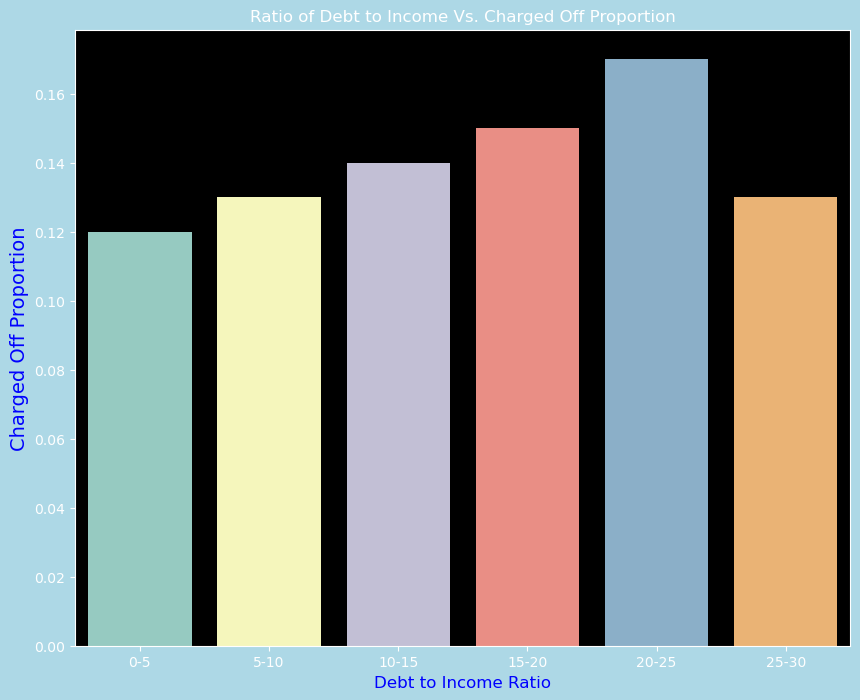

In [115]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='lightblue')
  ax.set(title='Ratio of Debt to Income Vs. Charged Off Proportion')
  ax=sns.barplot(x='loan_dti',y='Chargedoff_Proportion',data=dti_vs_status)
  ax.set_xlabel('Debt to Income Ratio',fontsize=12,color='b')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='b')

### **_Observations_**
#### Analysis of Loan Default Proportions vs Debt to Income Ratio
* *Loans with less dti have the lowest risk of being charged off.*
* *Loans with high dti have the highest risk of being charged off.*
* *The likelihood of a loan being charged off increases progressively as dti increases.*

In [117]:
loan_data.home_ownership.describe()

count     35475
unique        4
top        RENT
freq      17675
Name: home_ownership, dtype: object

In [118]:
loan_data['home_ownership'] = loan_data['home_ownership'].replace('NONE','OTHER')
home_ownership_vs_status=loan_data.groupby(["home_ownership","loan_status"]).home_ownership.count().unstack().fillna(0).reset_index()
home_ownership_vs_status["Total"]=home_ownership_vs_status["Charged Off"]+home_ownership_vs_status["Fully Paid"]
home_ownership_vs_status['Chargedoff_Proportion'] = round(home_ownership_vs_status['Charged Off'] / home_ownership_vs_status['Total'],2)
home_ownership_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,home_ownership,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,MORTGAGE,2013,12915,14928,0.13
2,OWN,414,2368,2782,0.15
3,RENT,2679,14996,17675,0.15
1,OTHER,17,73,90,0.19


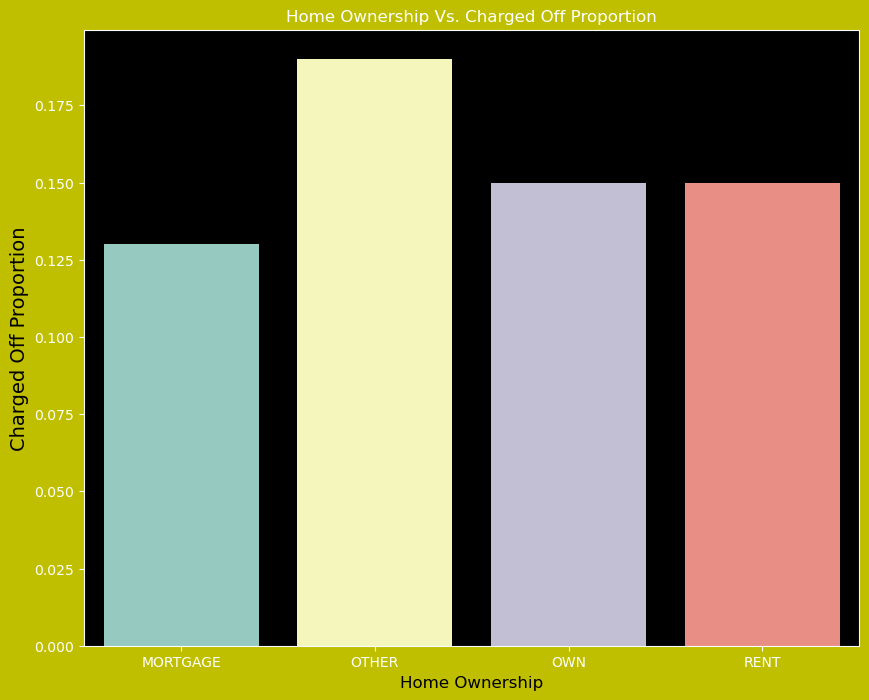

In [119]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='y')
  ax.set(title='Home Ownership Vs. Charged Off Proportion')
  ax=sns.barplot(x='home_ownership',y='Chargedoff_Proportion',data=home_ownership_vs_status)
  ax.set_xlabel('Home Ownership',fontsize=12,color='black')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='black')

### **_Observations_**
* *There is no Clear insight with this components.*

In [121]:
loan_data.verification_status.describe()

count            35475
unique               3
top       Not Verified
freq             16240
Name: verification_status, dtype: object

In [122]:
ver_status_vs_status=loan_data.groupby(["verification_status","loan_status"]).verification_status.count().unstack().fillna(0).reset_index()
ver_status_vs_status["Total"]=ver_status_vs_status["Charged Off"]+ver_status_vs_status["Fully Paid"]
ver_status_vs_status["Chargedoff_Proportion"]=round(ver_status_vs_status["Charged Off"]/ver_status_vs_status["Total"],2)
ver_status_vs_status.sort_values(by='Chargedoff_Proportion')

loan_status,verification_status,Charged Off,Fully Paid,Total,Chargedoff_Proportion
0,Not Verified,2087,14153,16240,0.13
1,Source Verified,1333,7655,8988,0.15
2,Verified,1703,8544,10247,0.17


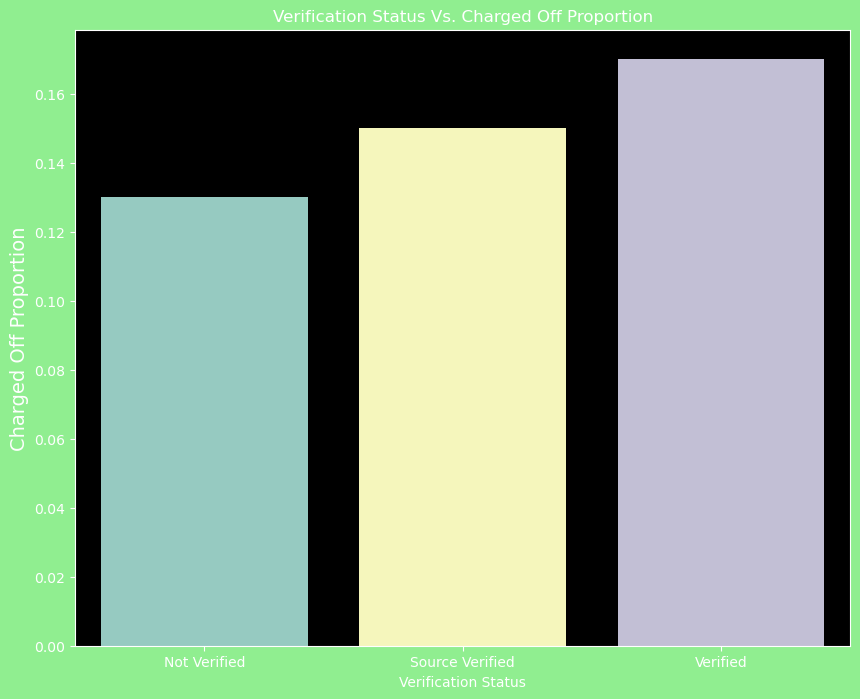

In [123]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='lightgreen')
  ax.set(title='Verification Status Vs. Charged Off Proportion')
  ax=sns.barplot(x='verification_status',y='Chargedoff_Proportion',data=ver_status_vs_status)
  ax.set_xlabel('Verification Status',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')

### **_Observations_**
* *There is no Clear insight with this components.*

In [125]:
loan_data.addr_state.describe()

count     35475
unique       50
top          CA
freq       6356
Name: addr_state, dtype: object

In [126]:
add_vs_status=loan_data.groupby(["addr_state","loan_status"]).addr_state.count().unstack().fillna(0).reset_index()
add_vs_status["Total"]=add_vs_status["Charged Off"]+add_vs_status["Fully Paid"]
add_vs_status["Charged_Off_Propotion"]=round(add_vs_status["Charged Off"]/add_vs_status["Total"],2)
add_vs_status.sort_values(by='Charged_Off_Propotion')

loan_status,addr_state,Charged Off,Fully Paid,Total,Charged_Off_Propotion
21,ME,0.0,3.0,3.0,0.00
12,IA,0.0,5.0,5.0,0.00
15,IN,0.0,9.0,9.0,0.00
49,WY,3.0,74.0,77.0,0.04
7,DC,11.0,173.0,184.0,0.06
8,DE,11.0,96.0,107.0,0.10
1,AL,46.0,357.0,403.0,0.11
2,AR,25.0,197.0,222.0,0.11
42,TX,269.0,2116.0,2385.0,0.11
26,MT,9.0,70.0,79.0,0.11


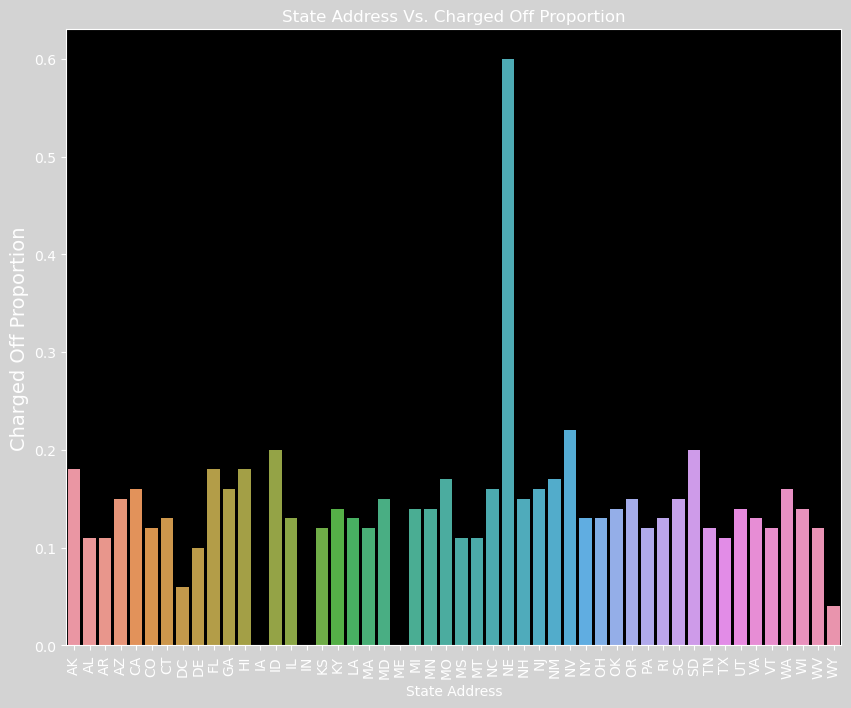

In [127]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='lightgray')
  ax.set(title='State Address Vs. Charged Off Proportion')
  ax=sns.barplot(x='addr_state',y='Charged_Off_Propotion',data=add_vs_status)
  plt.xticks(rotation=90)
  ax.set_xlabel('State Address',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')

### **_Observations_**
* *States NE are most likely to be charged off, but there aren't enough applications to make a determination.*
* *New York, California, and Florida have significant charge-off rates on their applications.*

In [129]:
loan_data.pub_rec.describe()

count    35475.000000
mean         0.057674
std          0.242145
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          4.000000
Name: pub_rec, dtype: float64

In [130]:
pub_vs_status=loan_data.groupby(["pub_rec","loan_status"]).pub_rec.count().unstack().fillna(0).reset_index()
pub_vs_status["Total"]=pub_vs_status["Charged Off"]+pub_vs_status["Fully Paid"]
pub_vs_status["Charged_Off_Propotion"]=round(pub_vs_status["Charged Off"]/pub_vs_status["Total"],2)
pub_vs_status.sort_values(by='Charged_Off_Propotion')

loan_status,pub_rec,Charged Off,Fully Paid,Total,Charged_Off_Propotion
3,3,0.0,6.0,6.0,0.00
4,4,0.0,2.0,2.0,0.00
0,0,4679.0,28814.0,33493.0,0.14
2,2,10.0,36.0,46.0,0.22
1,1,434.0,1494.0,1928.0,0.23


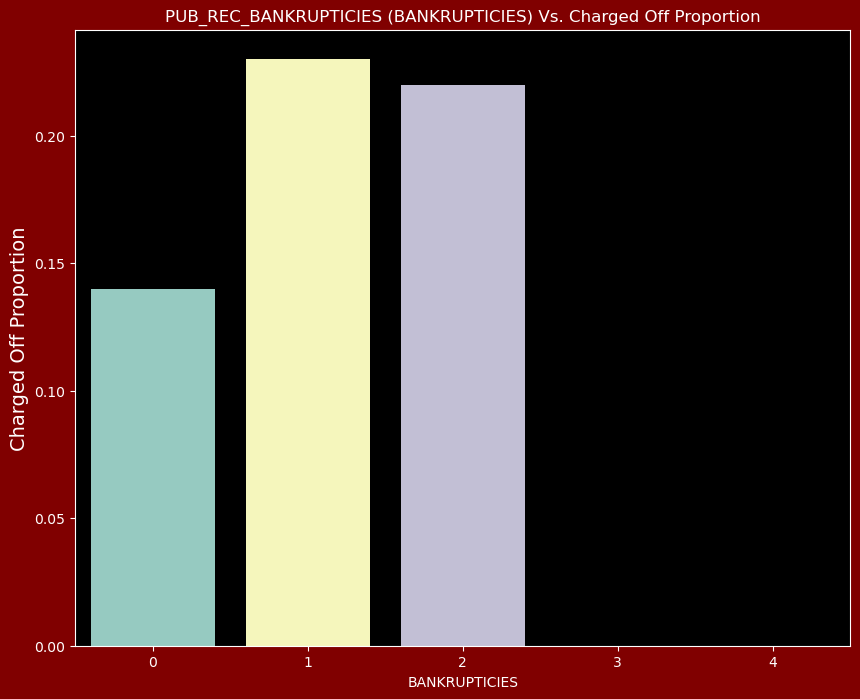

In [131]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='maroon')
  ax.set(title='PUB_REC_BANKRUPTICIES (BANKRUPTICIES) Vs. Charged Off Proportion')
  ax=sns.barplot(x='pub_rec',y='Charged_Off_Propotion',data=pub_vs_status)
  ax.set_xlabel('BANKRUPTICIES',fontsize=10,color='w')
  ax.set_ylabel('Charged Off Proportion',fontsize=14,color='w')

### **_Observations_**
* *Those with pub_rec_bankruptcies values 1 and 2 have higher charged-off percentage than those without pub_rec_bankruptcies.*

# <span style="background-color: yellow;text-align: center;">*_Bi variate Analysis with Two Different components_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_In this section, we will compare with some other bi variate components._*
* INTEREST RATE Vs PURPOSE OF LOAN
* LOAN AMOUNT Vs INTEREST RATE
* LOAN AMOUNT Vs GRADE
* EMP LENGTH (EMPLOYEE EXPERIENCE) Vs PUB_REC_BANKRUPTICIES (BANKRUPTICIES)
* ANNUAL INCOME Vs VERIFICATION STATUS

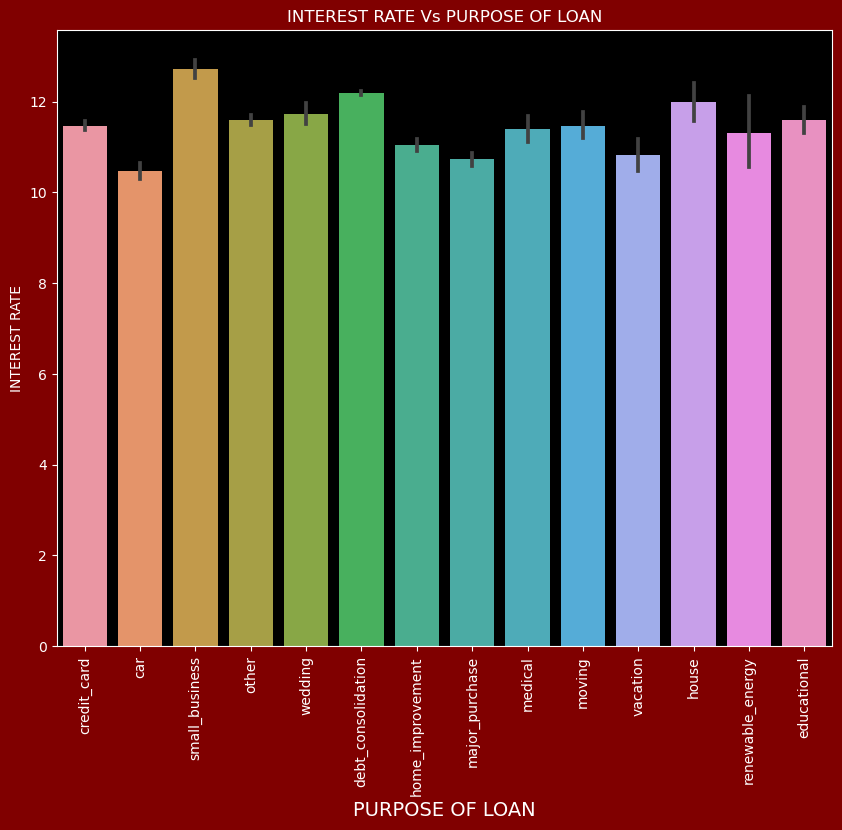

In [134]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='maroon')
  ax.set(title='INTEREST RATE Vs PURPOSE OF LOAN')
  ax=sns.barplot(x='purpose',y='int_rate',data=loan_data)
  ax.set_ylabel('INTEREST RATE',fontsize=10,color='w')
  ax.set_xlabel('PURPOSE OF LOAN',fontsize=14,color='w')
  plt.xticks(rotation=90)

### **_Observations_**
##### Analysis for INTEREST RATE Vs PURPOSE OF LOAN
* *Small Business and Debt Consolidation loan charges more rate of interest.*
* *Car loan charges less rate of interest.*

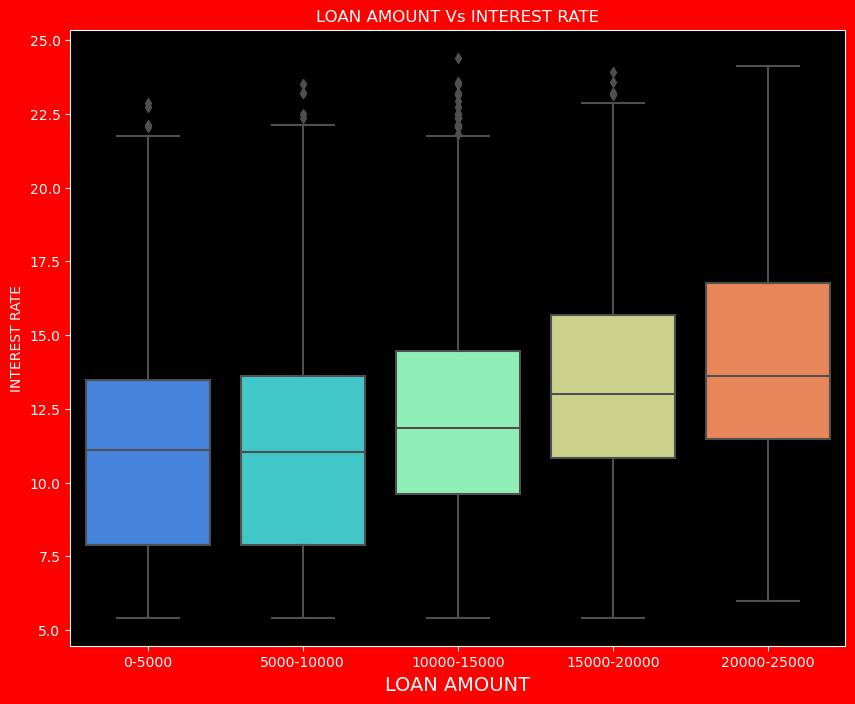

In [136]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='red')
  ax.set(title='LOAN AMOUNT Vs INTEREST RATE')
  ax=sns.boxplot(x='loan_amnt_cat',y='int_rate',data=loan_data,palette='rainbow')
  ax.set_ylabel('INTEREST RATE',fontsize=10,color='w')
  ax.set_xlabel('LOAN AMOUNT',fontsize=14,color='w')

### **_Observations_**
##### Analysis for INTEREST RATE Vs lOAN AMOUNT
* *Interest Rate is higher in higher loan amount.*
* *Charged off also higer in higher interest and loan amount*

In [138]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35475 entries, 0 to 39716
Data columns (total 31 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   loan_amnt             35475 non-null  int64   
 1   funded_amnt           35475 non-null  int64   
 2   funded_amnt_inv       35475 non-null  float64 
 3   term                  35475 non-null  object  
 4   int_rate              35475 non-null  float64 
 5   installment           35475 non-null  float64 
 6   grade                 35475 non-null  object  
 7   sub_grade             35475 non-null  object  
 8   emp_title             35475 non-null  object  
 9   emp_length            35475 non-null  int64   
 10  home_ownership        35475 non-null  object  
 11  annual_inc            35475 non-null  float64 
 12  verification_status   35475 non-null  object  
 13  issue_d               35475 non-null  object  
 14  loan_status           35475 non-null  object  
 15  purpose

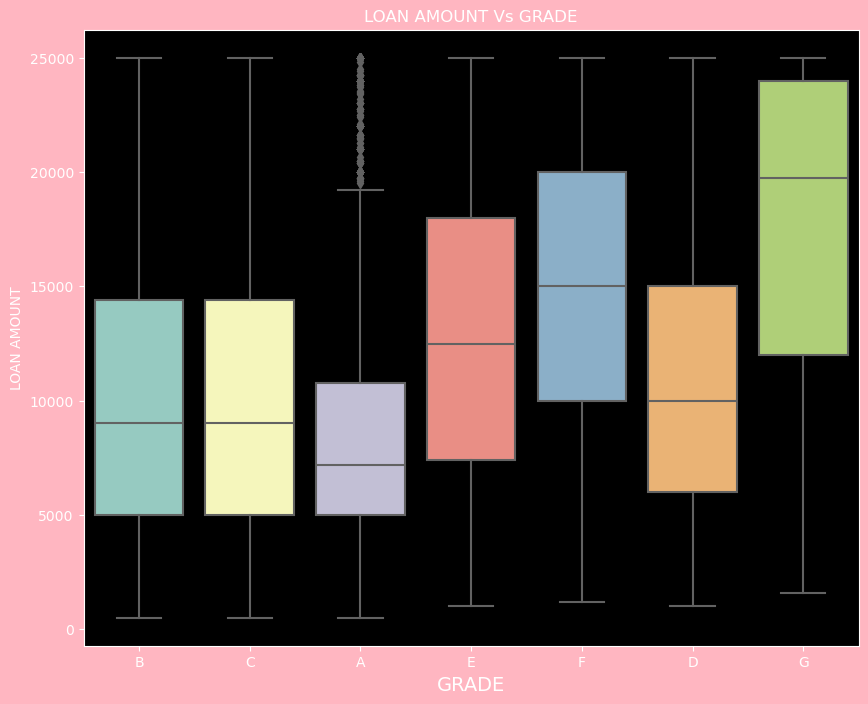

In [139]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='lightpink')
  ax.set(title='LOAN AMOUNT Vs GRADE')
  ax=sns.boxplot(x='grade',y='loan_amnt',data=loan_data)
  ax.set_ylabel('LOAN AMOUNT',fontsize=10,color='w')
  ax.set_xlabel('GRADE',fontsize=14,color='w')

### **_Observations_**
##### Analysis for GRADE Vs LOAN AMOUNT
* *Loan amount is higher in Grade G*
* *Loan amount is lesser in Grade A*

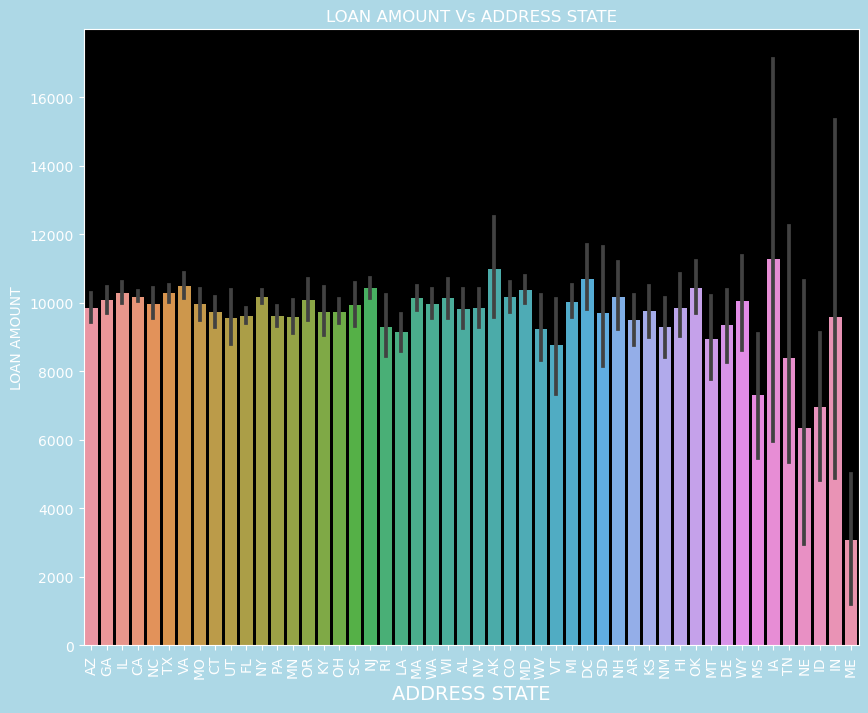

In [141]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='lightblue')
  ax.set(title='LOAN AMOUNT Vs ADDRESS STATE')
  ax=sns.barplot(x='addr_state',y='loan_amnt',data=loan_data)
  ax.set_ylabel('LOAN AMOUNT',fontsize=10,color='w')
  ax.set_xlabel('ADDRESS STATE',fontsize=14,color='w')
  plt.xticks(rotation=90)

### **_Observations_**
##### Analysis for Loan Amount VS State
* *Loan amount is higher in these states AK,DC & IA*
* *Loan amount is lesser in ME*

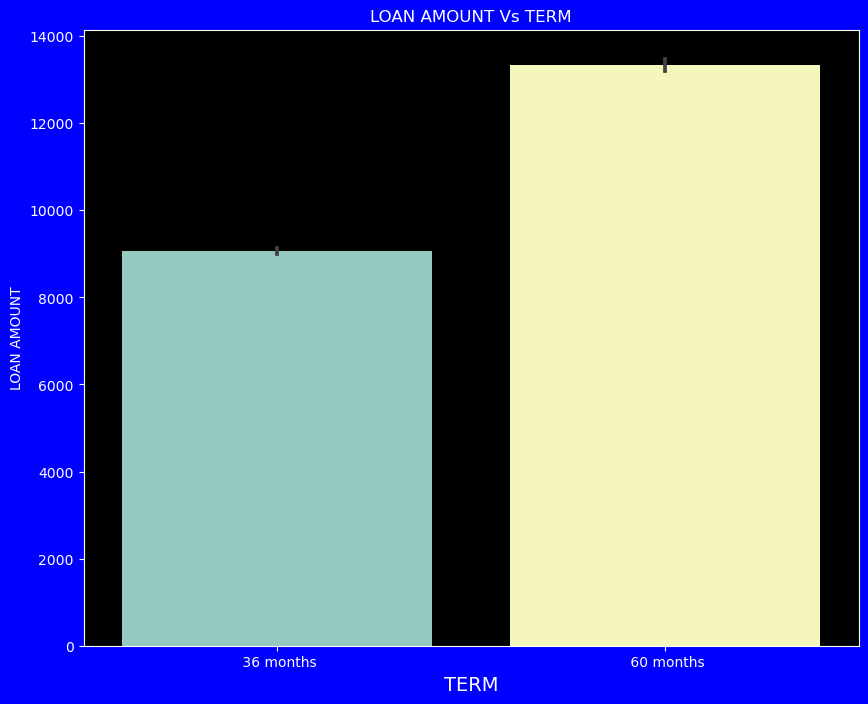

In [143]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='blue')
  ax.set(title='LOAN AMOUNT Vs TERM')
  ax=sns.barplot(x='term',y='loan_amnt',data=loan_data)
  ax.set_ylabel('LOAN AMOUNT',fontsize=10,color='w')
  ax.set_xlabel('TERM',fontsize=14,color='w')

### **_Observations_**
##### Analysis for TERM Vs lOAN AMOUNT
* *It is clear that loan amount is higher for 60 months loan term.*
* *Relatively less in 36 months loan term*

In [145]:
loan_data.inq_last_6mths.describe()

count    35475.000000
mean         0.862748
std          1.061782
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          8.000000
Name: inq_last_6mths, dtype: float64

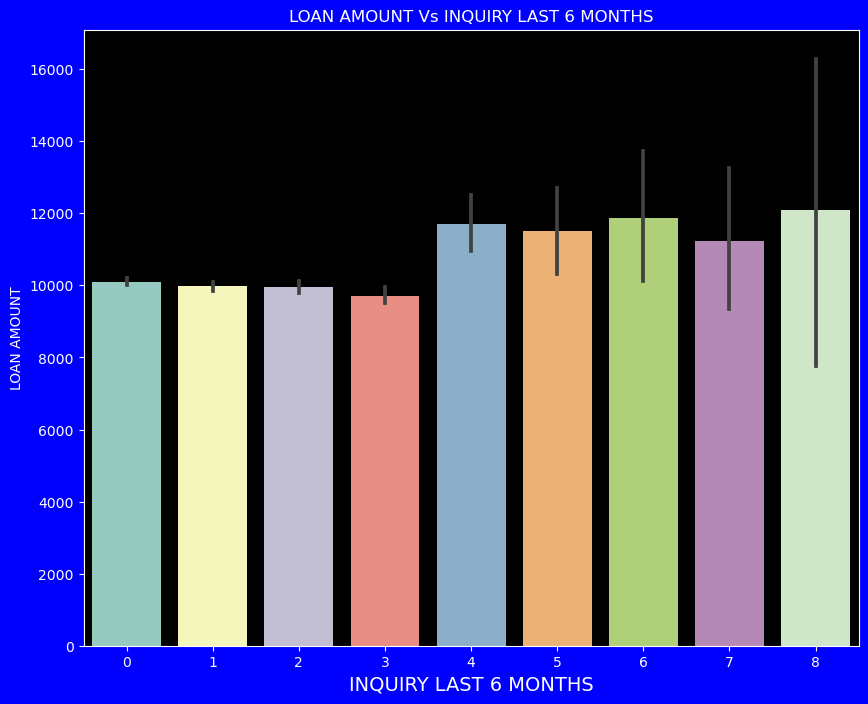

In [146]:
with plt.style.context('dark_background'):
  fig,ax=plt.subplots(figsize=(10,8),facecolor='blue')
  ax.set(title='LOAN AMOUNT Vs INQUIRY LAST 6 MONTHS')
  ax=sns.barplot(x='inq_last_6mths',y='loan_amnt',data=loan_data)
  ax.set_ylabel('LOAN AMOUNT',fontsize=10,color='w')
  ax.set_xlabel('INQUIRY LAST 6 MONTHS',fontsize=14,color='w')

### **_Observations_**
##### Analysis for INQUIRY LAST 6 MONTHS Vs lOAN AMOUNT
* *More number of inquries for larger amount.*

In [148]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35475 entries, 0 to 39716
Data columns (total 31 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   loan_amnt             35475 non-null  int64   
 1   funded_amnt           35475 non-null  int64   
 2   funded_amnt_inv       35475 non-null  float64 
 3   term                  35475 non-null  object  
 4   int_rate              35475 non-null  float64 
 5   installment           35475 non-null  float64 
 6   grade                 35475 non-null  object  
 7   sub_grade             35475 non-null  object  
 8   emp_title             35475 non-null  object  
 9   emp_length            35475 non-null  int64   
 10  home_ownership        35475 non-null  object  
 11  annual_inc            35475 non-null  float64 
 12  verification_status   35475 non-null  object  
 13  issue_d               35475 non-null  object  
 14  loan_status           35475 non-null  object  
 15  purpose

In [149]:
loan_data['dti_categories']=pd.cut(loan_data['dti'],[0,5,10,15,20,25],labels=['0-5','5-10','10-15','15-20','25+'])
loan_data.dti_categories.describe()

count     34739
unique        5
top       10-15
freq       8896
Name: dti_categories, dtype: object

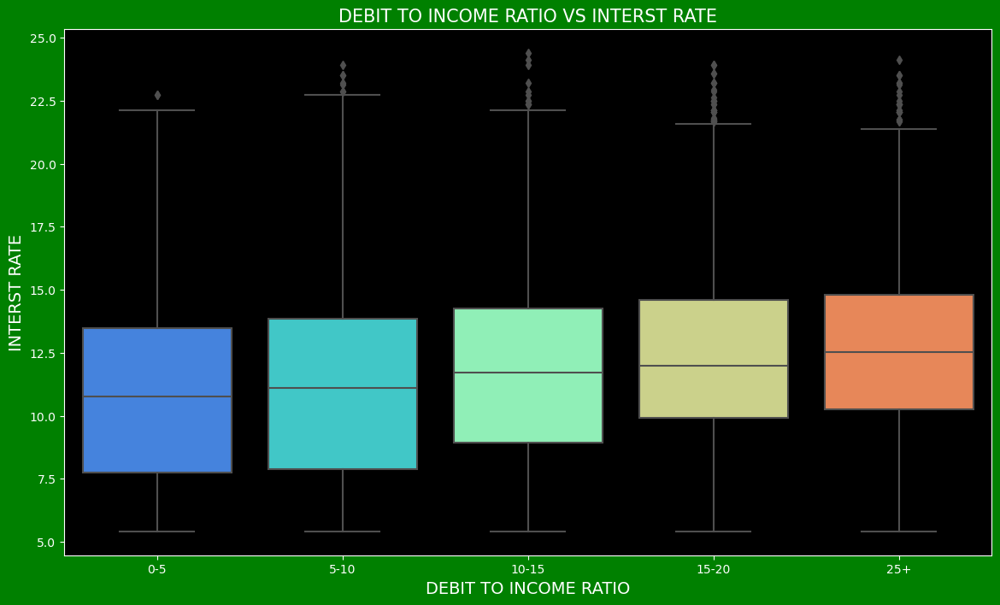

In [150]:
with plt.style.context('dark_background'):
  plt.figure(figsize=(14,8),facecolor='GREEN')
  ax = sns.boxplot(y='int_rate', x='dti_categories', data =loan_data,palette='rainbow')
  ax.set_title('DEBIT TO INCOME RATIO VS INTERST RATE',fontsize=15,color='w')
  ax.set_ylabel('INTERST RATE',fontsize=14,color = 'w')
  ax.set_xlabel('DEBIT TO INCOME RATIO',fontsize=14,color = 'w')
  plt.show()

### **_Observations_**
##### Analysis for 'DEBIT TO INCOME RATIO VS INTERST RATE
* *Debt-to-income (DTI) ratio is low,  might qualify for a lower interest rate.*

In [152]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35475 entries, 0 to 39716
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   loan_amnt             35475 non-null  int64   
 1   funded_amnt           35475 non-null  int64   
 2   funded_amnt_inv       35475 non-null  float64 
 3   term                  35475 non-null  object  
 4   int_rate              35475 non-null  float64 
 5   installment           35475 non-null  float64 
 6   grade                 35475 non-null  object  
 7   sub_grade             35475 non-null  object  
 8   emp_title             35475 non-null  object  
 9   emp_length            35475 non-null  int64   
 10  home_ownership        35475 non-null  object  
 11  annual_inc            35475 non-null  float64 
 12  verification_status   35475 non-null  object  
 13  issue_d               35475 non-null  object  
 14  loan_status           35475 non-null  object  
 15  purpose

In [153]:
loan_data["loan_status_val"]=loan_data["loan_status"]
loan_data['loan_status_val'] = loan_data['loan_status_val'].apply(lambda x: pd.to_numeric(0) if x=='Fully Paid' else pd.to_numeric(1))

# <span style="background-color: yellow;text-align: center;">*_SEGMENT ANALYSIS_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_In this section, we will segment the purpose of loan  with some other components._*
* TERM Vs PURPOSE OF LOAN
* HOME OWNERSHIP Vs PURPOSE OF LOAN
* GRADE Vs PURPOSE OF LOAN
* EMP LENGTH Vs PURPOSE OF LOAN
* YEAR Vs PURPOSE OF LOAN

In [155]:
#define a function for bar plot with loan status against various component
def seganlys_ln_status_bar_plot(x_variable,x_label,y_label,title):
    with plt.style.context('dark_background'):
      plt.figure(figsize=(10,8),facecolor='lightgreen')
      title = title
      x_label=x_label
      y_label=y_label
      plt.title(title)
      plt.xticks(rotation=90)
      ax = sns.barplot(x=str(x_variable), y='loan_status_val', data=loan_data, palette = "husl")
      ax.set(xlabel=x_label, ylabel=y_label)
      plt.show()

In [156]:
#define a function for count plot with loan status against various component
def seganlys_cnt_plot(x_variable,x_label,y_label,title):
  with plt.style.context('dark_background'):
      plt.figure(figsize=(10,8),facecolor='lightgreen')
      title = title
      x_label=x_label
      y_label=y_label
      plt.title(title)
      plt.xticks(rotation=90)
      ax =sns.countplot(x=str(x_variable), data=loan_data, palette = "flare")
      ax.set(xlabel=x_label, ylabel=y_label)
      plt.show()

In [157]:
loan_data['purpose'].value_counts()

purpose
debt_consolidation    16610
credit_card            4653
other                  3633
home_improvement       2454
major_purchase         2017
small_business         1515
car                    1444
wedding                 882
medical                 633
moving                  546
vacation                363
house                   322
educational             309
renewable_energy         94
Name: count, dtype: int64

In [158]:
main_purposes = ["credit_card","small_business","debt_consolidation","home_improvement","house","educational","medical"]
loan_data["Seg_purpose"] = loan_data[loan_data['purpose'].isin(main_purposes)].purpose
loan_data["Seg_purpose"].value_counts()

Seg_purpose
debt_consolidation    16610
credit_card            4653
home_improvement       2454
small_business         1515
medical                 633
house                   322
educational             309
Name: count, dtype: int64

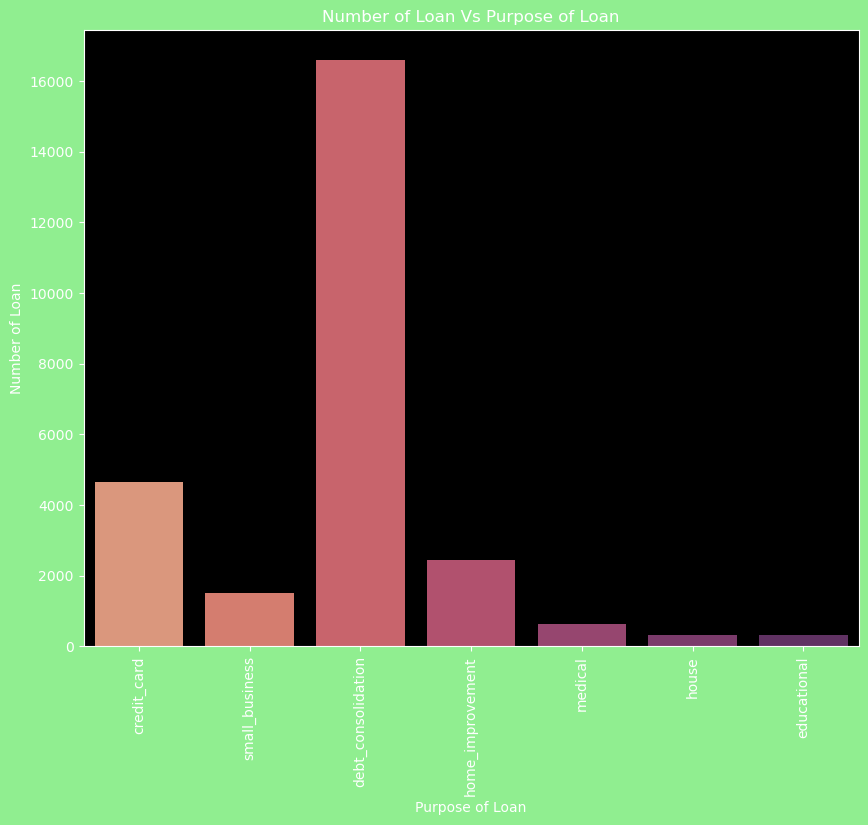

In [159]:
seganlys_cnt_plot("Seg_purpose","Purpose of Loan","Number of Loan",'Number of Loan Vs Purpose of Loan' )

### **_Observations_**
##### Analysis for Number of Loan Vs Purpose of Loan
* *Number of Loan is higher in Consolidating the various debit loan.*
* *Education and house loans are comparatively fewer in number.*

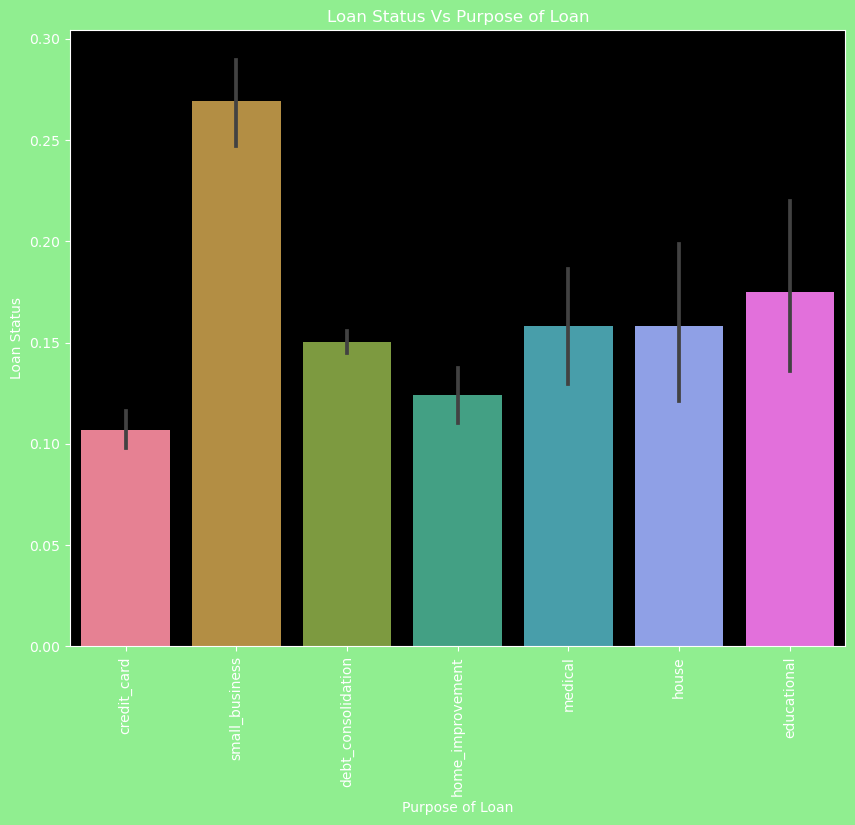

In [161]:
seganlys_ln_status_bar_plot("Seg_purpose","Purpose of Loan","Loan Status",'Loan Status Vs Purpose of Loan' )

### **_Observations_**
##### Analysis for Loan Status Vs Purpose of Loan
* *The number of defaulters is highest in small business loans, followed by educational loans.*
* *There are comparatively fewer defaulters in credit card loans.*

In [163]:
def seganlys_cat_variable_plot(x_variable,x_label,y_label,title,color):
   with plt.style.context('dark_background'):
    plt.figure(figsize=(10,8),facecolor=color)
    plt.xticks(rotation=90)
    title = title
    x_label=x_label
    y_label=y_label
    plt.title(title)
    plt.xticks(rotation=90)
    ax = sns.barplot(x=str(x_variable), y='loan_status_val', hue='Seg_purpose',data=loan_data, palette = "husl")
    ax.set(xlabel=x_label, ylabel=y_label)
    plt.show()        

In [164]:
loan_data.groupby(["Seg_purpose","term","loan_status_val"]).term.count()


Seg_purpose         term        loan_status_val
credit_card          36 months  0                   3534
                                1                    301
                     60 months  0                    621
                                1                    197
debt_consolidation   36 months  0                  11058
                                1                   1403
                     60 months  0                   3055
                                1                   1094
educational          36 months  0                    246
                                1                     47
                     60 months  0                      9
                                1                      7
home_improvement     36 months  0                   1642
                                1                    187
                     60 months  0                    507
                                1                    118
house                36 months  0       

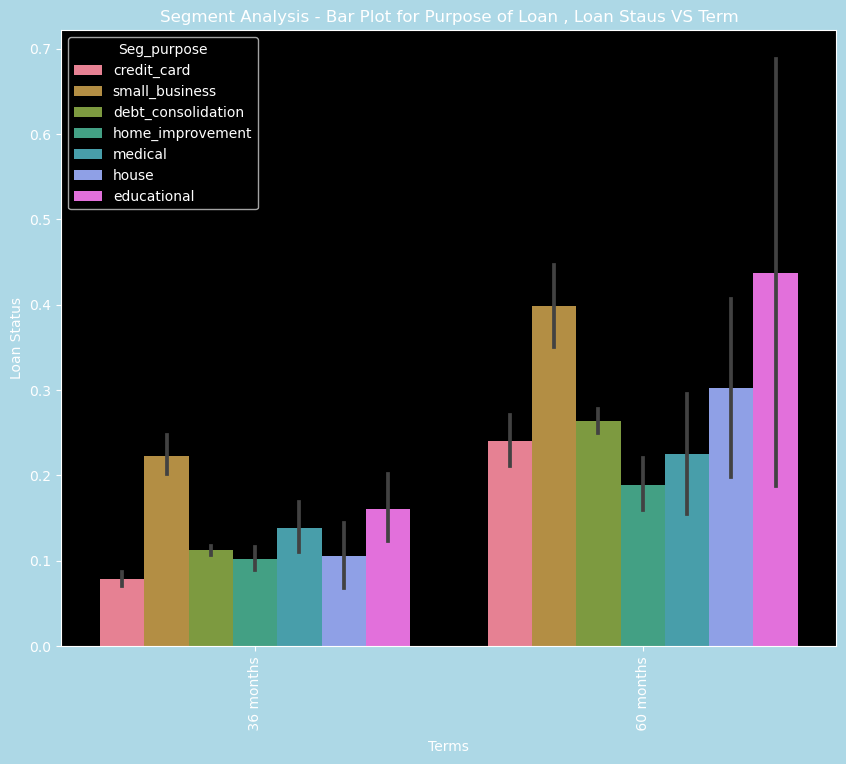

In [165]:
seganlys_cat_variable_plot("term","Terms","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Staus VS Term','lightblue')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Staus VS Term
* *The number of defaulters is highest in small business loans, followed by educational loans in short term.*
* *The number of defaulters is highest in educational loans, followed by  small business loans in long term.*
* *Similarly there is differnce in long term and short term for housing and medical loans.*

In [167]:
loan_data.groupby(["Seg_purpose","grade","loan_status_val"]).grade.count().unstack().fillna(0)

loan_status_val                0      1
Seg_purpose        grade               
credit_card        A      1278.0   62.0
                   B      1378.0  140.0
                   C       839.0  138.0
                   D       428.0   87.0
                   E       164.0   51.0
                   F        55.0   18.0
                   G        13.0    2.0
debt_consolidation A      3458.0  237.0
                   B      4535.0  609.0
                   C      2956.0  606.0
                   D      1939.0  549.0
                   E       876.0  310.0
                   F       277.0  144.0
                   G        72.0   42.0
educational        A        75.0    4.0
                   B        76.0   20.0
                   C        74.0   14.0
                   D        20.0    9.0
                   E         7.0    6.0
                   F         2.0    1.0
                   G         1.0    0.0
home_improvement   A       826.0   39.0
                   B       651.0   89.0
                   C       348.0   88.0
                   D       186.0   49.0
                   E        95.0   29.0
                   F        32.0   10.0
                   G        11.0    1.0
house              A        90.0    3.0
                   B        79.0    7.0
                   C        46.0   12.0
                   D        34.0   11.0
                   E        14.0   10.0
                   F         6.0    6.0
                   G         2.0    2.0
medical            A       184.0   12.0
                   B       158.0   30.0
                   C        95.0   27.0
                   D        58.0   19.0
                   E        30.0    7.0
                   F         7.0    4.0
                   G         1.0    1.0
small_business     A       281.0   39.0
                   B       291.0  102.0
                   C       204.0   82.0
                   D       167.0   81.0
                   E        99.0   58.0
                   F        42.0   29.0
                   G        23.0   17.0

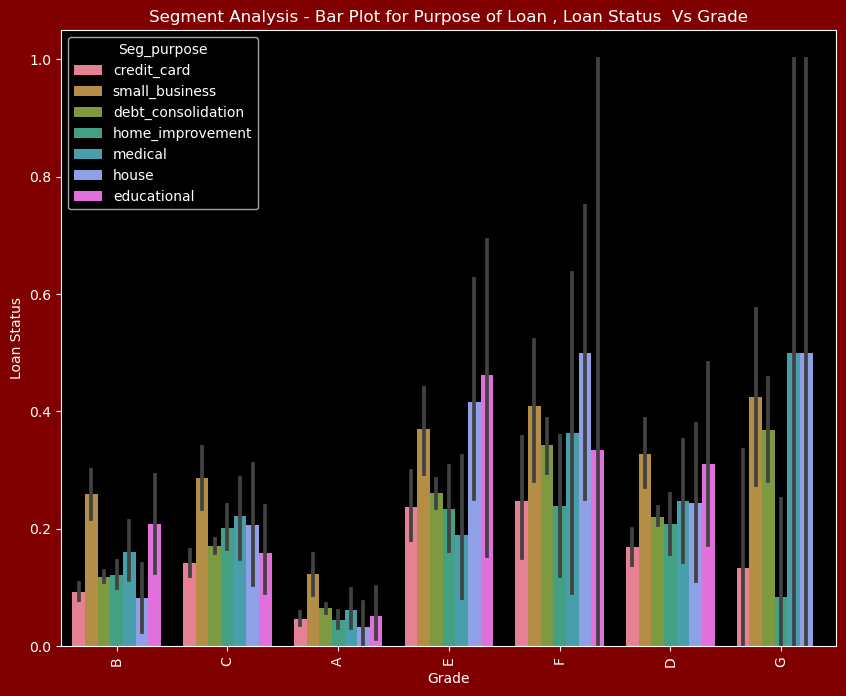

In [168]:
seganlys_cat_variable_plot("grade","Grade","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status  Vs Grade','maroon')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status  Vs Grade
* *The number of defaulters is highest in Grade A house and medical loans, followed by debit consolidation loans and small business.*
* *The number of defaulters in  small business Grade A ,B, C and D is higher.*
* *Similarly all loans defaulters are less in Grade A.*

In [170]:
loan_data.groupby(["Seg_purpose","emp_length","loan_status_val"]).emp_length.count().unstack().fillna(0)

loan_status_val                     0      1
Seg_purpose        emp_length               
credit_card        1            910.0   88.0
                   2            471.0   45.0
                   3            431.0   46.0
                   4            376.0   44.0
                   5            318.0   50.0
                   6            230.0   30.0
                   7            193.0   29.0
                   8            139.0   16.0
                   9            146.0   14.0
                   10           941.0  136.0
debt_consolidation 1           2761.0  464.0
                   2           1646.0  251.0
                   3           1512.0  238.0
                   4           1273.0  195.0
                   5           1208.0  203.0
                   6            848.0  154.0
                   7            646.0  122.0
                   8            540.0   98.0
                   9            463.0   86.0
                   10          3216.0  686.0
educational        1             94.0   18.0
                   2             36.0    8.0
                   3             18.0    7.0
                   4             23.0    8.0
                   5             17.0    4.0
                   6             10.0    0.0
                   7              8.0    1.0
                   8              6.0    0.0
                   9              7.0    1.0
                   10            36.0    7.0
home_improvement   1            273.0   55.0
                   2            214.0   28.0
                   3            207.0   25.0
                   4            172.0   20.0
                   5            172.0   29.0
                   6            127.0   13.0
                   7             95.0   11.0
                   8            106.0   11.0
                   9             74.0   10.0
                   10           709.0  103.0
house              1             48.0    9.0
                   2             38.0   10.0
                   3             35.0    3.0
                   4             26.0    5.0
                   5             27.0    2.0
                   6              8.0    4.0
                   7             12.0    5.0
                   8             10.0    3.0
                   9              8.0    0.0
                   10            59.0   10.0
medical            1            100.0   24.0
                   2             64.0   10.0
                   3             53.0   10.0
                   4             47.0    6.0
                   5             38.0    6.0
                   6             25.0    4.0
                   7             19.0    6.0
                   8             20.0    6.0
                   9             14.0    0.0
                   10           153.0   28.0
small_business     1            270.0  107.0
                   2            135.0   38.0
                   3            126.0   48.0
                   4             95.0   43.0
                   5             84.0   29.0
                   6             56.0   17.0
                   7             59.0   14.0
                   8             33.0   16.0
                   9             34.0    3.0
                   10           215.0   93.0

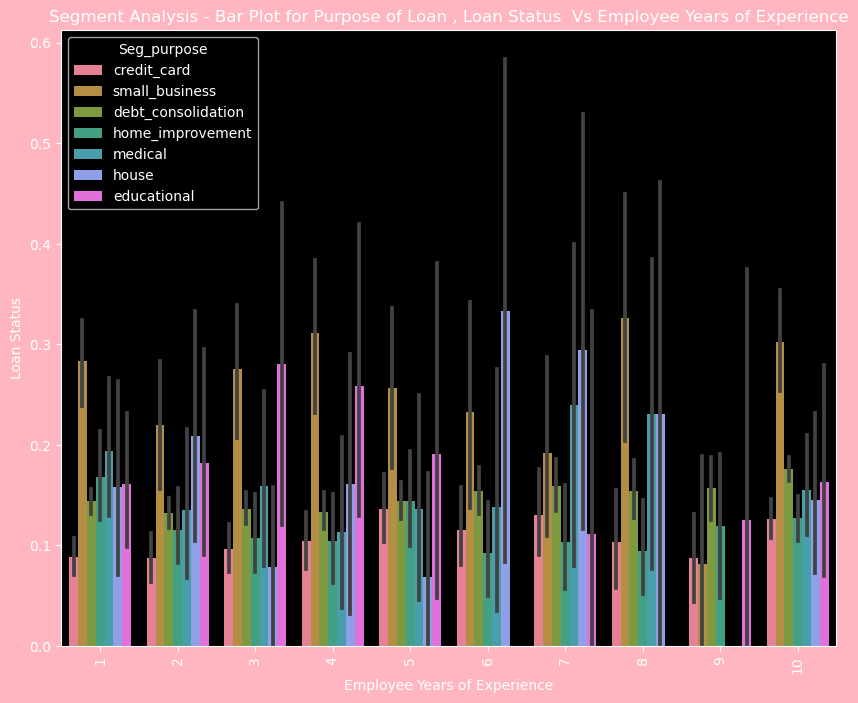

In [171]:
seganlys_cat_variable_plot("emp_length","Employee Years of Experience","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status  Vs Employee Years of Experience','lightpink')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status  Vs Employee Years of Experience
* *The number of defaulters are higher in 6 years of experience.*
* *The number of defaulters are higher in small business category irrespective of years of experience.*
* *Similarly credit card defaulters are in lesser for all age of experience.*

In [173]:
loan_data.groupby(["Seg_purpose","home_ownership","loan_status_val"]).home_ownership.count().unstack().fillna(0)

loan_status_val                         0       1
Seg_purpose        home_ownership                
credit_card        MORTGAGE        1749.0   199.0
                   OTHER              9.0     2.0
                   OWN              238.0    35.0
                   RENT            2159.0   262.0
debt_consolidation MORTGAGE        5574.0   989.0
                   OTHER             32.0     6.0
                   OWN             1005.0   183.0
                   RENT            7502.0  1319.0
educational        MORTGAGE          70.0    11.0
                   OTHER              3.0     0.0
                   OWN               15.0     5.0
                   RENT             167.0    38.0
home_improvement   MORTGAGE        1689.0   228.0
                   OTHER              4.0     1.0
                   OWN              249.0    41.0
                   RENT             207.0    35.0
house              MORTGAGE          98.0    15.0
                   OTHER              1.0     0.0
                   OWN               25.0     3.0
                   RENT             147.0    33.0
medical            MORTGAGE         223.0    38.0
                   OTHER              2.0     0.0
                   OWN               54.0    10.0
                   RENT             254.0    52.0
small_business     MORTGAGE         559.0   167.0
                   OTHER              6.0     4.0
                   OWN               63.0    30.0
                   RENT             479.0   207.0

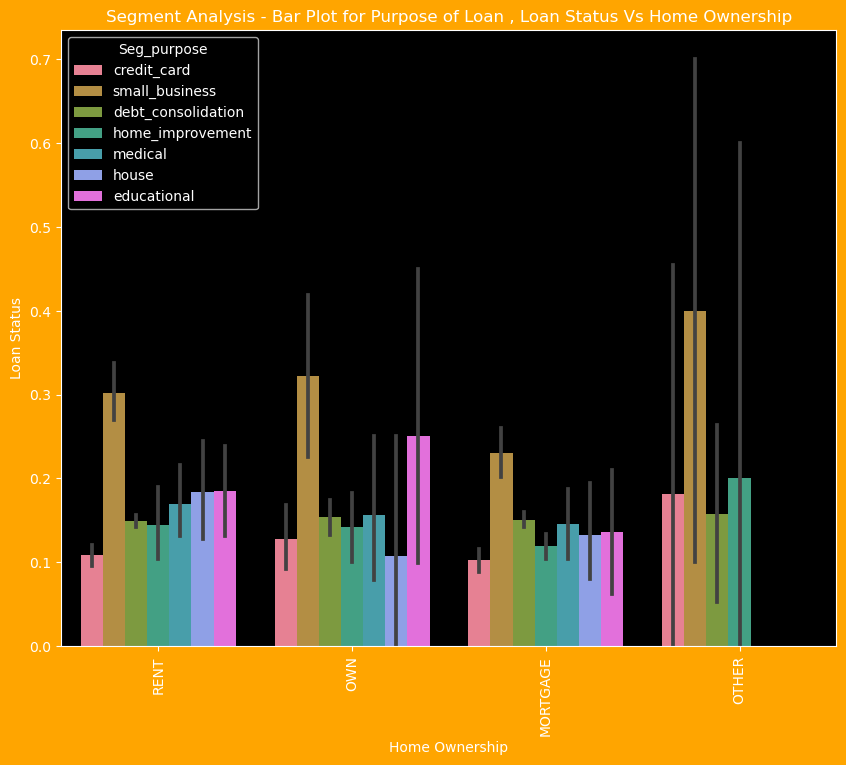

In [174]:
seganlys_cat_variable_plot("home_ownership","Home Ownership","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Home Ownership','orange')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Home Ownership
* *Housing loan defulters are high in rented house.*
* *The number of defaulters are higher in small business category are having own house.*
* *Similarly debit consolidation defaulters are in all home ownership category .*

In [176]:
## Extracting month and year
loan_data_month_year = loan_data['issue_d'].str.partition("-", True)    
loan_data['issue_day']=loan_data_month_year[1]                       
loan_data['issue_month']=loan_data_month_year[0]                       
loan_data['issue_year']='20' + loan_data_month_year[2]
loan_data.groupby(["Seg_purpose","issue_year","loan_status_val"]).issue_year.count().unstack().fillna(0)

loan_status_val                     0       1
Seg_purpose        issue_year                
credit_card        2007          40.0     1.0
                   2008         219.0    32.0
                   2009         487.0    45.0
                   2010        1233.0   125.0
                   2011        2176.0   295.0
debt_consolidation 2007          60.0    15.0
                   2008         506.0   102.0
                   2009        1678.0   229.0
                   2010        4422.0   678.0
                   2011        7447.0  1473.0
educational        2007          10.0     2.0
                   2008          40.0    11.0
                   2009         126.0    24.0
                   2010          79.0    17.0
home_improvement   2007          11.0     3.0
                   2008          74.0    14.0
                   2009         260.0    35.0
                   2010         682.0    88.0
                   2011        1122.0   165.0
house              2008          11.0     1.0
                   2009          44.0    12.0
                   2010          69.0    16.0
                   2011         147.0    22.0
medical            2007           1.0     0.0
                   2008          20.0     2.0
                   2009          63.0    14.0
                   2010         165.0    27.0
                   2011         284.0    57.0
small_business     2007          15.0     8.0
                   2008          59.0    21.0
                   2009         234.0    66.0
                   2010         288.0   103.0
                   2011         511.0   210.0

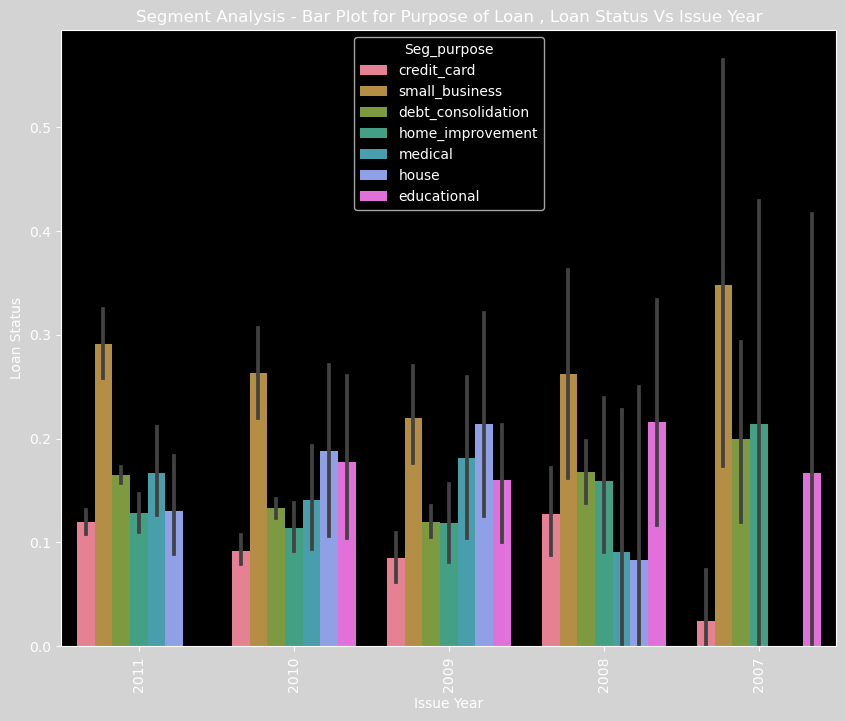

In [177]:
seganlys_cat_variable_plot("issue_year","Issue Year","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Issue Year','lightgrey')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Issue Year
* *All cateogry other than credit card loan defaulters are higher in the year 2007 compare to other years.*
* *The number of house loan defaulters are higher in the year 2009.*
* *Similarly small businsss defaulters are higher in all years .*

# <span style="background-color: yellow;text-align: center;">*_SEGMENT ANALYSIS_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_In this section, we will segment the purpose of loan  with some other components with binning the factor_*
* ANNUAL INCOME Vs PURPOSE OF LOAN
* LOAN AMOUNT Vs PURPOSE OF LOAN
* INTEREST RATE  Vs PURPOSE OF LOAN
* DEBIT TO INCOME RATIO Vs PURPOSE OF LOAN

In [180]:
# Create Bin with Annual Income
def fn_annul_inc_bin(annual_inc):
    if annual_inc <= 50000:
        return 'low'
    elif annual_inc > 50000 and annual_inc <=100000:
        return 'medium'
    else:
        return 'high'

loan_data['annual_inc_bin_val'] = loan_data['annual_inc'].apply(lambda x: fn_annul_inc_bin(x))

In [181]:
loan_data.groupby(["Seg_purpose","annual_inc_bin_val","loan_status_val"]).annual_inc_bin_val.count().unstack().fillna(0)

loan_status_val                           0     1
Seg_purpose        annual_inc_bin_val            
credit_card        high                 462    32
                   low                 1597   242
                   medium              2096   224
debt_consolidation high                1204   138
                   low                 5929  1241
                   medium              6980  1118
educational        high                  18     4
                   low                  154    35
                   medium                83    15
home_improvement   high                 348    27
                   low                  648   115
                   medium              1153   163
house              high                  23     7
                   low                  106    25
                   medium               142    19
medical            high                  46     5
                   low                  253    49
                   medium               234    46
small_business     high                 126    29
                   low                  423   180
                   medium               558   199

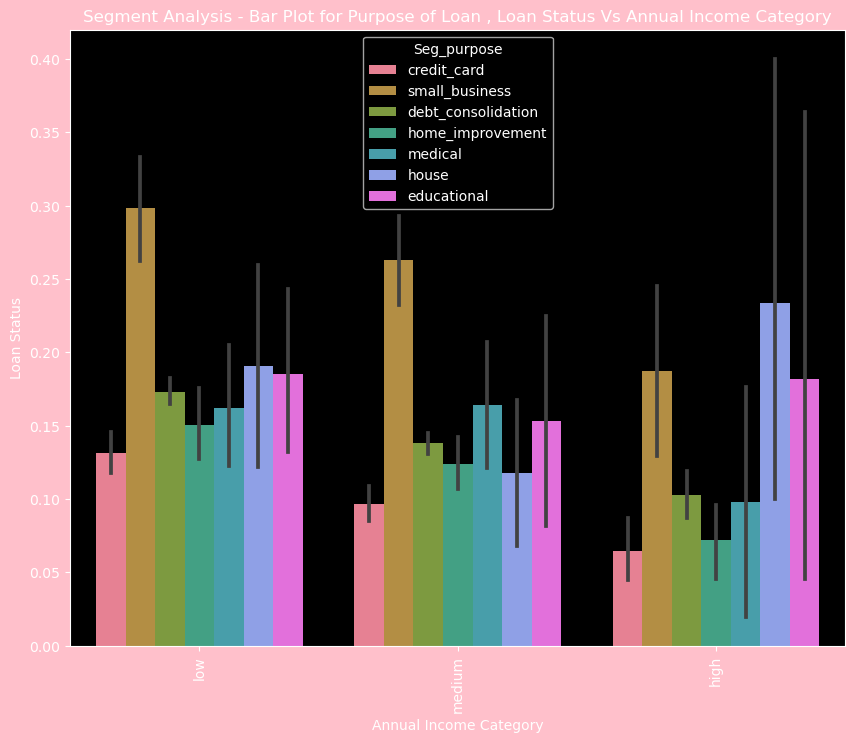

In [182]:
seganlys_cat_variable_plot("annual_inc_bin_val","Annual Income Category","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Annual Income Category','pink')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Annual Income Category
* *Small business loan defaulters are higher in all Annual income group*
* *The number of house loan and education defaulters are higher in high Annual income group.*
* *The number of small business and credit card loan defaulters are higher in low and medium Annual income group.*

In [184]:
loan_data.loan_amnt.describe()

count    35475.000000
mean     10037.187456
std       6079.154865
min        500.000000
25%       5000.000000
50%       9000.000000
75%      14000.000000
max      25000.000000
Name: loan_amnt, dtype: float64

In [185]:
# Create Bin with Loan Amount
def fn_loan_amnt_bin(loan_amnt):
    if loan_amnt <= 5000:
        return 'low'
    elif loan_amnt > 5000 and loan_amnt <=10000:
        return 'medium'
    else:
        return 'high'

loan_data['loan_amnt_bin_val'] = loan_data['loan_amnt'].apply(lambda x: fn_loan_amnt_bin(x))

In [186]:
loan_data.groupby(["Seg_purpose","loan_amnt_bin_val","loan_status_val"]).loan_amnt_bin_val.count().unstack().fillna(0)

loan_status_val                          0     1
Seg_purpose        loan_amnt_bin_val            
credit_card        high               1811   255
                   low                 787    75
                   medium             1557   168
debt_consolidation high               6809  1314
                   low                2382   426
                   medium             4922   757
educational        high                 39    11
                   low                 133    22
                   medium               83    21
home_improvement   high                723   120
                   low                 651    81
                   medium              775   104
house              high                119    19
                   low                  54    11
                   medium               98    21
medical            high                118    28
                   low                 234    40
                   medium              181    32
small_business     high                475   221
                   low                 256    77
                   medium              376   110

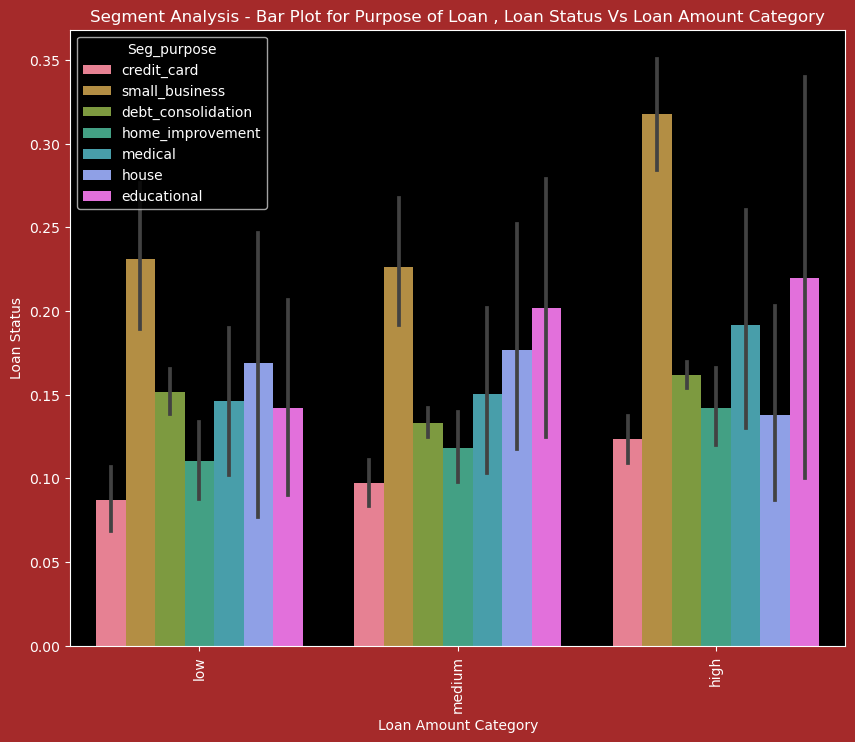

In [187]:
seganlys_cat_variable_plot("loan_amnt_bin_val","Loan Amount Category","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Loan Amount Category','brown')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Loan Amount Category
* *Small business loan defaulters are higher in all Loan amount category*
* *The number of education defaulters are higher in medium and high Loan amount category.*
* *The number of credit card loan defaulters are lesser in low Loan amount category.*

In [189]:
loan_data.int_rate.describe()

count    35475.000000
mean        11.766285
std          3.591897
min          5.420000
25%          8.900000
50%         11.710000
75%         14.220000
max         24.400000
Name: int_rate, dtype: float64

In [190]:
# Create Bin with interest rate
def fn_int_rate_bin(int_rate):
    if int_rate <= 8:
        return 'low'
    elif int_rate > 8 and int_rate <=15:
        return 'medium'
    else:
        return 'high'

loan_data['int_rate_bin_val'] = loan_data['int_rate'].apply(lambda x: fn_int_rate_bin(x))

In [191]:
loan_data.groupby(["Seg_purpose","int_rate_bin_val","loan_status_val"]).int_rate_bin_val.count().unstack().fillna(0)

loan_status_val                         0     1
Seg_purpose        int_rate_bin_val            
credit_card        high               562   143
                   low               1005    48
                   medium            2588   307
debt_consolidation high              2729   960
                   low               2861   179
                   medium            8523  1358
educational        high                15    11
                   low                 35     1
                   medium             205    42
home_improvement   high               286    86
                   low                710    25
                   medium            1153   194
house              high                51    29
                   low                 74     2
                   medium             146    20
medical            high                82    30
                   low                160     7
                   medium             291    63
small_business     high               289   163
                   low                231    27
                   medium             587   218

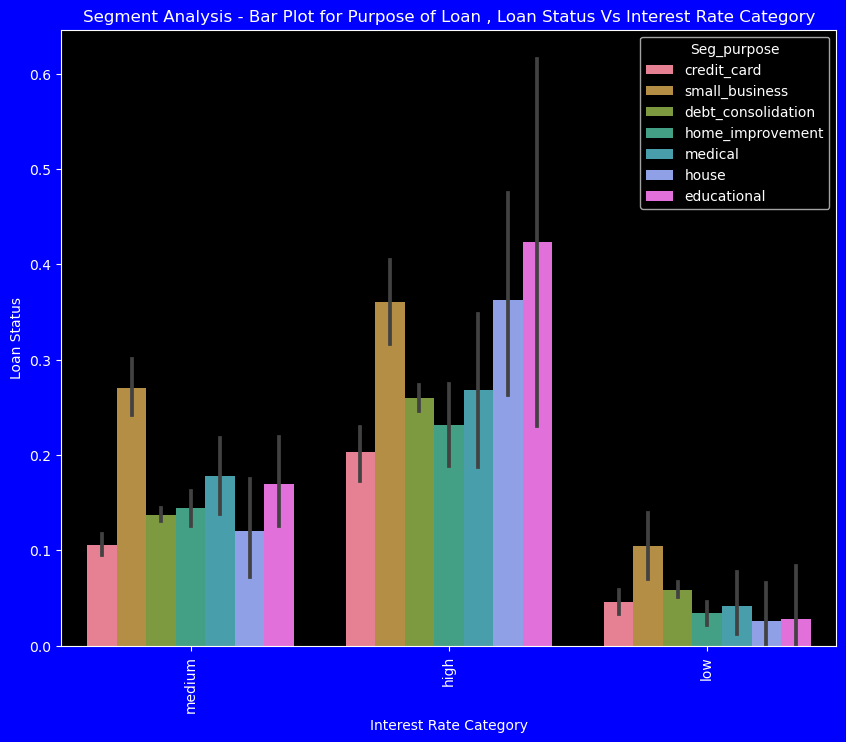

In [192]:
seganlys_cat_variable_plot("int_rate_bin_val","Interest Rate Category","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Interest Rate Category','blue')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs Interest Rate Category
* *All loan defaulters are lesser in number when interest rate is less*
* *All loan defaulters are higher when the rate of interest is high.*
* *Defaulters are directly propotional to rate of interest*

In [194]:
loan_data.dti.describe()

count    35475.000000
mean        13.409949
std          6.659378
min          0.000000
25%          8.310000
50%         13.520000
75%         18.680000
max         29.990000
Name: dti, dtype: float64

In [195]:
# Create Bin with Debit to Income Ratio
def fn_dti_bin(dti):
    if dti <= 10:
        return 'low'
    elif dti > 10 and dti <=20:
        return 'medium'
    else:
        return 'high'

loan_data['dti_bin_val'] = loan_data['dti'].apply(lambda x: fn_dti_bin(x))

In [196]:
loan_data.groupby(["Seg_purpose","dti_bin_val","loan_status_val"]).dti_bin_val.count().unstack().fillna(0)

loan_status_val                    0     1
Seg_purpose        dti_bin_val            
credit_card        high          887   135
                   low          1026   101
                   medium       2242   262
debt_consolidation high         3111   632
                   low          3768   549
                   medium       7234  1316
educational        high           23    10
                   low           109    23
                   medium        123    21
home_improvement   high          270    49
                   low           964   124
                   medium        915   132
house              high           32     4
                   low           128    20
                   medium        111    27
medical            high           75    19
                   low           202    42
                   medium        256    39
small_business     high          144    60
                   low           540   174
                   medium        423   174

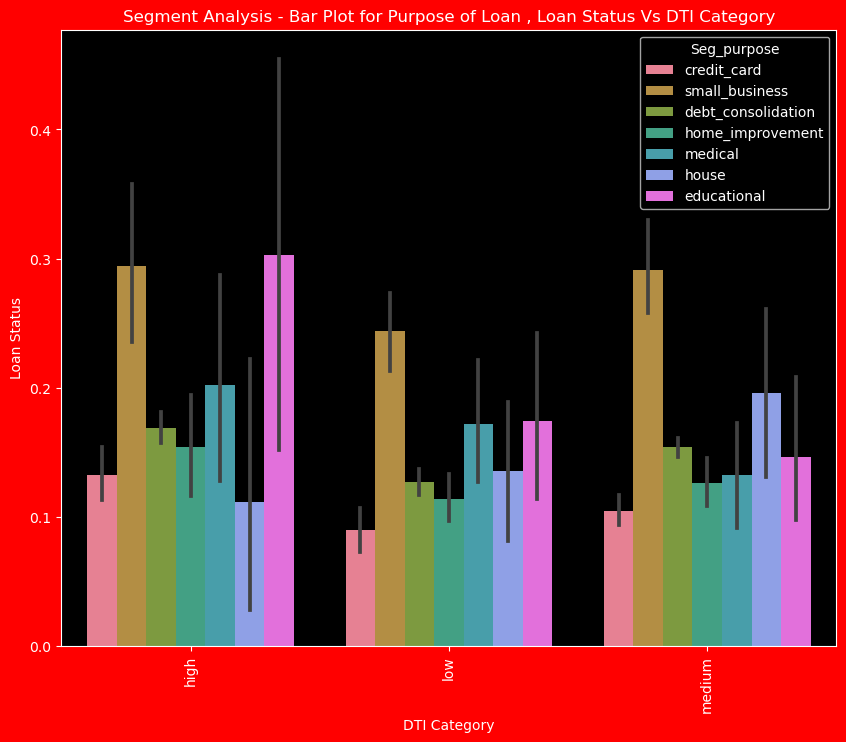

In [197]:
seganlys_cat_variable_plot("dti_bin_val","DTI Category","Loan Status",'Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs DTI Category','red')

### **_Observations_**
##### Segment Analysis - Bar Plot for Purpose of Loan , Loan Status Vs DTI Category
* *Educational and Small business loan defaulters are higher in number when DTI is high*
* *Credit card and Debit consolidation loan defaulters are higher when DTI is high and medium.*

# <span style="background-color: yellow;text-align: center;">*_MULTIVARIATE ANALYSIS_*   
# <span style="background-color: orange;text-align: center;font-size: 20px;">*_In this section, we will create pair plot with few critical columns from the dataset for multivariate analysis._*
* ANNUAL INCOME 
* LOAN AMOUNT
* INTEREST RATE
* LOAN ISSUE YEAR

In [200]:
# We are constructing a fresh copy of this data frame for multivariate analysis by selecting a few critical columns from the dataset individually.

loan_data_mv_df = loan_data[['loan_amnt', 'annual_inc', 'issue_year','int_rate','loan_status']].copy()
loan_data_mv_df.head()

,loan_amnt,annual_inc,issue_year,int_rate,loan_status
0,5000,24000.0,2011,10.65,Fully Paid
1,2500,30000.0,2011,15.27,Charged Off
2,2400,12252.0,2011,15.96,Fully Paid
3,10000,49200.0,2011,13.49,Fully Paid
5,5000,36000.0,2011,7.90,Fully Paid


In [201]:
# We are using the log of the variables listed below ,because they are extremely skewed.
loan_data_mv_df['loan_amnt'] = np.log10(loan_data_mv_df['loan_amnt'])
loan_data_mv_df['annual_inc'] = np.log10(loan_data_mv_df['annual_inc'])
loan_data_mv_df['int_rate'] = np.log10(loan_data_mv_df['int_rate'])

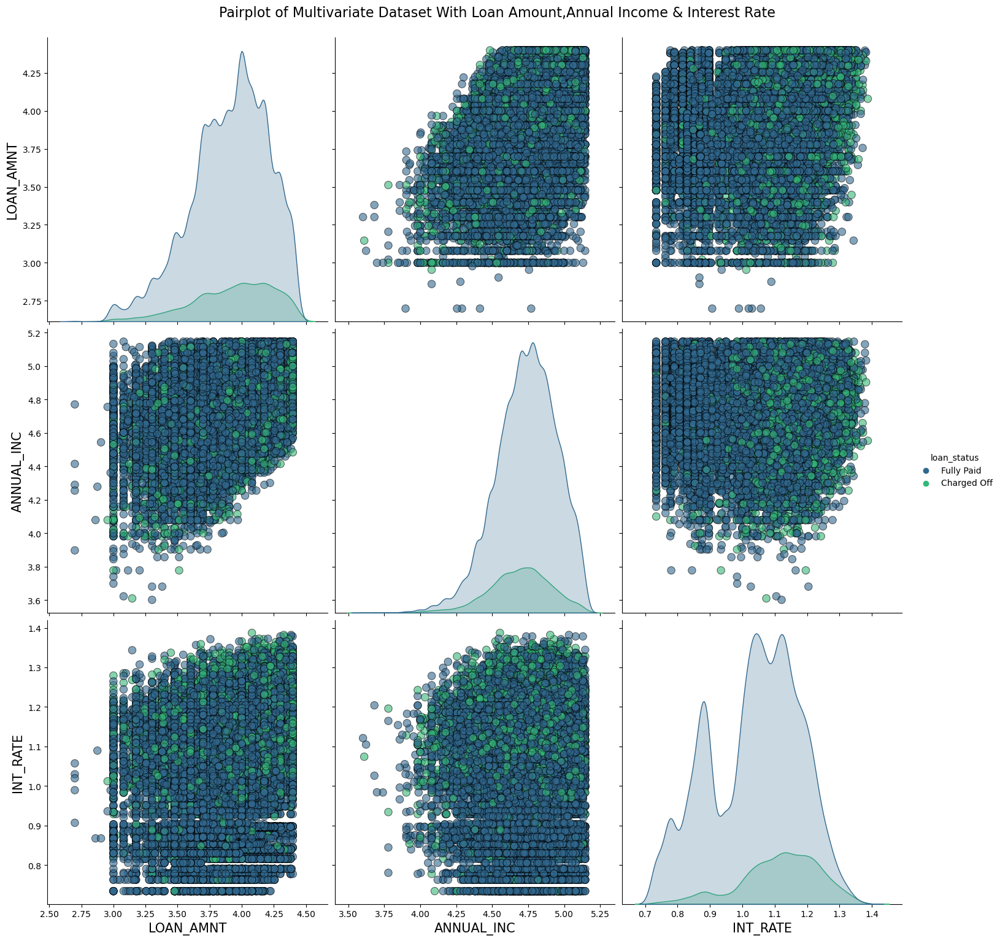

In [202]:
pairplt = sns.pairplot(loan_data_mv_df, hue = 'loan_status', diag_kind = 'auto', palette = "viridis",
             plot_kws = {'alpha': 0.6, 's': 80, 'edgecolor': 'k'},
             size = 5)
for ax in pairplt.axes.flatten():
    ax.set_xlabel(ax.get_xlabel().upper(), fontsize=15)
    ax.set_ylabel(ax.get_ylabel().upper(), fontsize=15)
plt.suptitle('Pairplot of Multivariate Dataset With Loan Amount,Annual Income & Interest Rate', y=1.02, fontsize=16)
plt.show()

### **_Observations_**
##### Multivariate Analysis - Pairplot of Multivariate Dataset With Loan Amount,Annual Income & Interest Rate
* *A higher charged-off ratio indicates a higher interest rate.*
* *As annual income increases, the loan amount increases slightly.*
* *The interest rate increases with the loan amount, and as it does, there is a significant charge off.*

### **_The above plot is too dense, so let's focus on the year 2010 to gain some insights._**

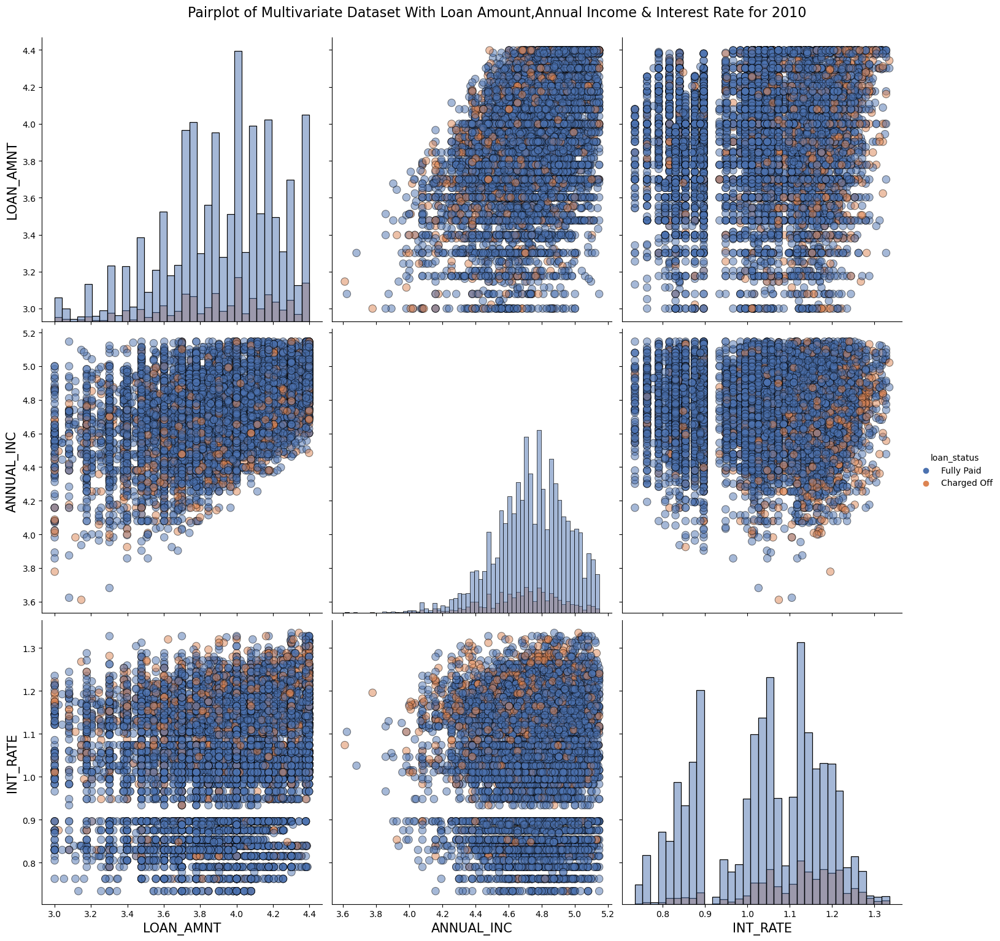

In [205]:

pairplt = sns.pairplot(loan_data_mv_df[loan_data_mv_df['issue_year'] == "2010"], vars = ['loan_amnt', 'annual_inc', 'int_rate'], hue = 'loan_status', diag_kind = 'hist', palette = "deep",
             plot_kws = {'alpha': 0.5, 's': 80, 'edgecolor': 'k'},
             size = 5)
for ax in pairplt.axes.flatten():
    ax.set_xlabel(ax.get_xlabel().upper(), fontsize=15)
    ax.set_ylabel(ax.get_ylabel().upper(), fontsize=15)
plt.suptitle('Pairplot of Multivariate Dataset With Loan Amount,Annual Income & Interest Rate for 2010', y=1.02, fontsize=16)
plt.show()

### **_Observations_**
##### Multivariate Analysis - 2010 Pairplot of Multivariate Dataset With Loan Amount,Annual Income & Interest Rate
* *A higher charged-off ratio indicates a higher interest rate.*
* *As annual income increases, the loan amount increases slightly.*
* *The interest rate increases with the loan amount, and as it does, there is a significant charge off.*

### **Key Findings:**
### Amount Categories Distribution
- All four amount categories exhibit similar distribution shapes.
- Most loan amounts range from $5,000 to $15,000.

### Annual Income
- Annual incomes mostly range from $40,000 to $80,000.
- Higher annual incomes correlate with:
  - Larger loans
  - Higher revolving balances
  - Higher total payments

### Interest Rates
- Interest rates primarily fall between 9-14%.
- Higher interest rates (20%-25%) result in more charge-offs.
- Interest rates decrease with longer employee tenure.
- Higher delinquencies and recent credit inquiries are linked to higher interest rates.

### Debt Consolidation
- Debt consolidation is the most common loan purpose, with many charged-off loans linked to it.
- Loans for debt consolidation are the most common.

### Loan Amounts and Correlations
- Loan amount, funding amount, and funded amount invested are highly correlated.
- Larger loans lead to higher total payments.
- Loans between $20,000 and $25,000 have higher charge-off rates.
- Higher loan amounts and interest rates are linked to higher charge-offs.
- Longer loan terms (60 months) have higher loan amounts.
- More inquiries are associated with larger loan amounts.

### Debt-to-Income Ratio (DTI)
- High debt-to-income (DTI) ratios are linked to high revolving balances.
- Higher DTI loans are more likely to be charged off.
- Higher DTI loans have more defaulters, especially in educational and small business loans.

### Loan Purpose and Defaults
- Small business loans have the highest charge-off rates.
- Wedding loans have the least charge-offs.
- Small business loans have the highest number of defaulters, followed by educational loans.
- House loan defaulters are higher in rented houses.
- Small business loan defaulters are higher among those who own homes.
- Education and housing loans are fewer.

### Loan Grades and Default Risks
- Loans with Grade A and Sub Grade A have the lowest charge-off risks.
- Grades/Sub Grades F and G have the highest charge-off risks.

### Employment and Charge-Offs
- Unemployed individuals or those with less than one year of experience are more likely to be charged off.

### Geographic and Bankruptcy Insights
- States like New York, California, and Florida have high charge-off rates.
- Those with public record bankruptcies have higher charge-off percentages.

### Interest Rate and Loan Types
- Small Business and Debt Consolidation loans charge higher interest rates.
- Car loans charge less interest.
- Higher charged-off ratios indicate higher interest rates.

### Historical and Income Group Insights
- Defaulters are more common in years like 2007 and 2009.
- Small business loan defaulters span all annual income groups.
- Higher-income groups see more house and education loan defaulters.
- Higher loan amounts see more defaulters across categories.
- All loan defaulters are fewer when interest rates are low and higher when rates are high.

### Charge-Off Trends
- As annual income increases, loan amounts and interest rates also increase, leading to more charge-offs.